In [227]:
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

from sklearn.metrics import mean_absolute_percentage_error as mape
from sklearn.metrics import mean_squared_error as mse

In [3]:
df = pd.read_csv("./tobii_test_sub_pred.csv")

In [8]:
def distance(x1, y1, x2, y2):
    return np.sqrt((x1 - x2)**2 + (y1 - y2)**2)

In [5]:
df.columns

Index(['paths', 'x_normalized', 'y_normalized', 'full_name', 'pred_x',
       'pred_y'],
      dtype='object')

In [9]:
df["distances"] = df[['x_normalized', 'y_normalized', 'pred_x', 'pred_y']].apply(lambda x: distance(*x), axis = 1)

In [226]:
df[df.y_normalized == 1.5]

,paths,x_normalized,y_normalized,full_name,pred_x,pred_y,distances


In [167]:
sorted_df = df.sort_values("distances")

In [168]:
sorted_df[sorted_df["x_normalized"] > 1.5]

,paths,x_normalized,y_normalized,full_name,pred_x,pred_y,distances
8163,/home/ubuntu/projects/tweakle/data/tobii_image...,3.547366,0.07811,P_17#1491942071066_20_-study-tooth_abscess_ins...,0.199648,0.254144,3.352343


In [24]:
sorted_df[(sorted_df["y_normalized"] < 1.1) & (sorted_df["y_normalized"] > 1.0)]

,paths,x_normalized,y_normalized,full_name,pred_x,pred_y,distances
10378,/home/ubuntu/projects/tweakle/data/tobii_image...,0.113424,1.007879,P_45#1492719205697_12_-study-educational_advan...,0.359685,0.833074,0.301996
8312,/home/ubuntu/projects/tweakle/data/tobii_image...,0.441976,1.022737,P_60#1493219365171_12_-study-educational_advan...,0.402979,0.721361,0.303889
14385,/home/ubuntu/projects/tweakle/data/tobii_image...,0.428511,1.091123,P_24#1492106295971_16_-study-where_to_find_mor...,0.413065,0.784474,0.307039
6218,/home/ubuntu/projects/tweakle/data/tobii_image...,0.543242,1.018773,P_20#1492020948838_22_-study-educational_advan...,0.404924,0.732523,0.317916
11652,/home/ubuntu/projects/tweakle/data/tobii_image...,0.472484,1.055852,P_02#1491487691210_11_-study-benefits_of_runni...,0.476883,0.693769,0.362109
4740,/home/ubuntu/projects/tweakle/data/tobii_image...,0.577493,1.090925,P_29#1492189262993_26_-study-where_to_find_mor...,0.428896,0.714686,0.404520
11073,/home/ubuntu/projects/tweakle/data/tobii_image...,0.356063,1.094146,P_64#1493237348836_20_-study-where_to_find_mor...,0.377832,0.687945,0.406785
3293,/home/ubuntu/projects/tweakle/data/tobii_image...,0.376739,1.094872,P_60#1493219365171_9_-study-benefits_of_runnin...,0.322406,0.690848,0.407660
7940,/home/ubuntu/projects/tweakle/data/tobii_image...,0.348489,1.005298,P_24#1492106295971_10_-study-benefits_of_runni...,0.505263,0.619318,0.416604
2085,/home/ubuntu/projects/tweakle/data/tobii_image...,0.397753,1.003181,P_58#1493212090222_12_-study-educational_advan...,0.303427,0.597080,0.416912


In [66]:
tmp = sorted_df[(sorted_df["y_normalized"] != 1.5) & (sorted_df["y_normalized"] > 1.1)]

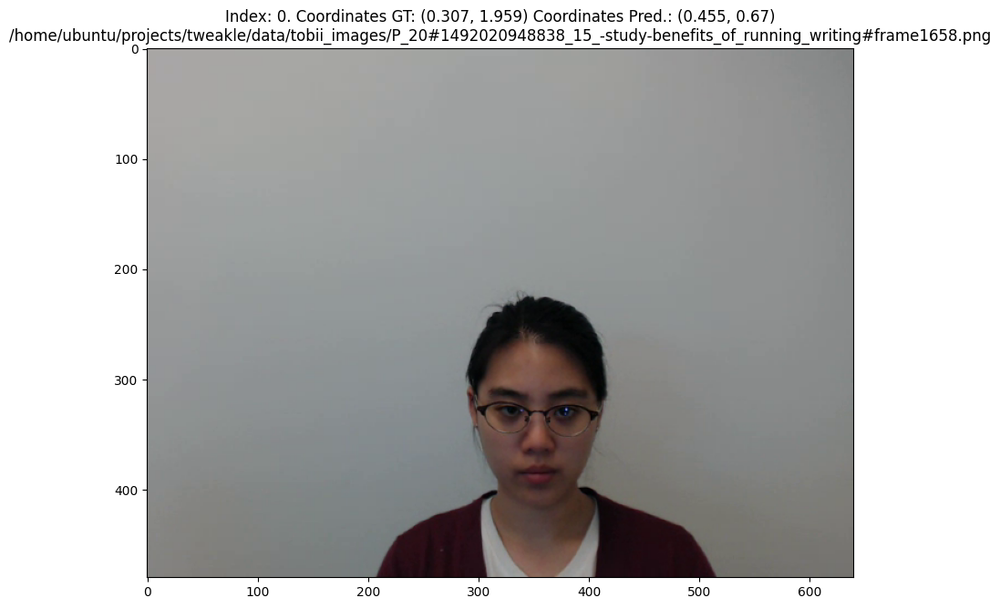

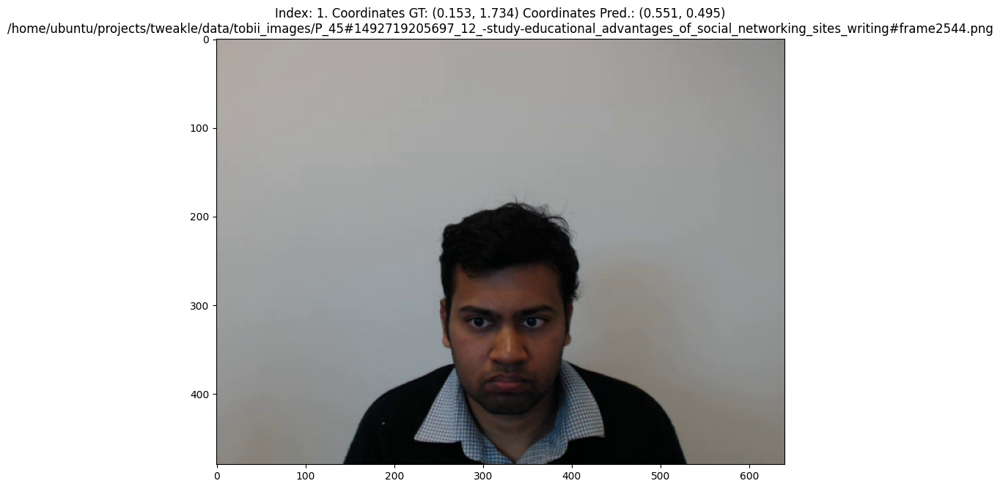

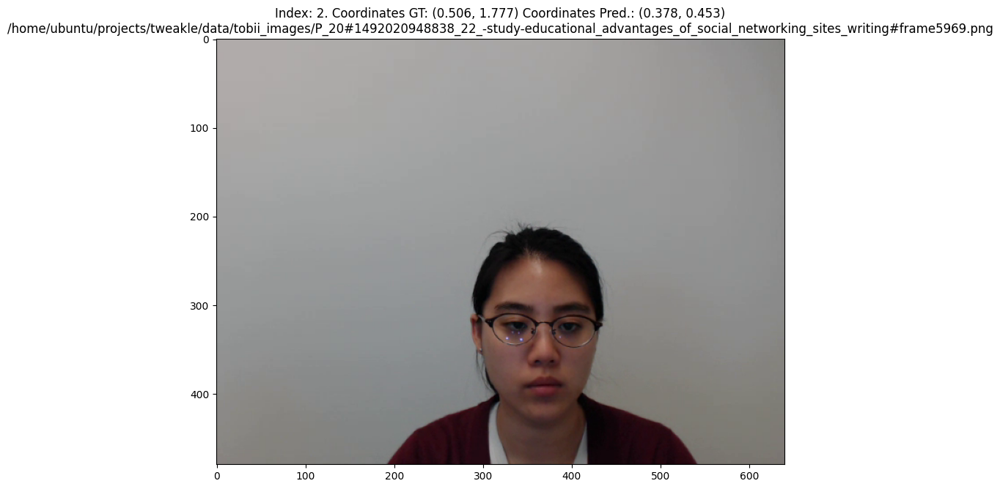

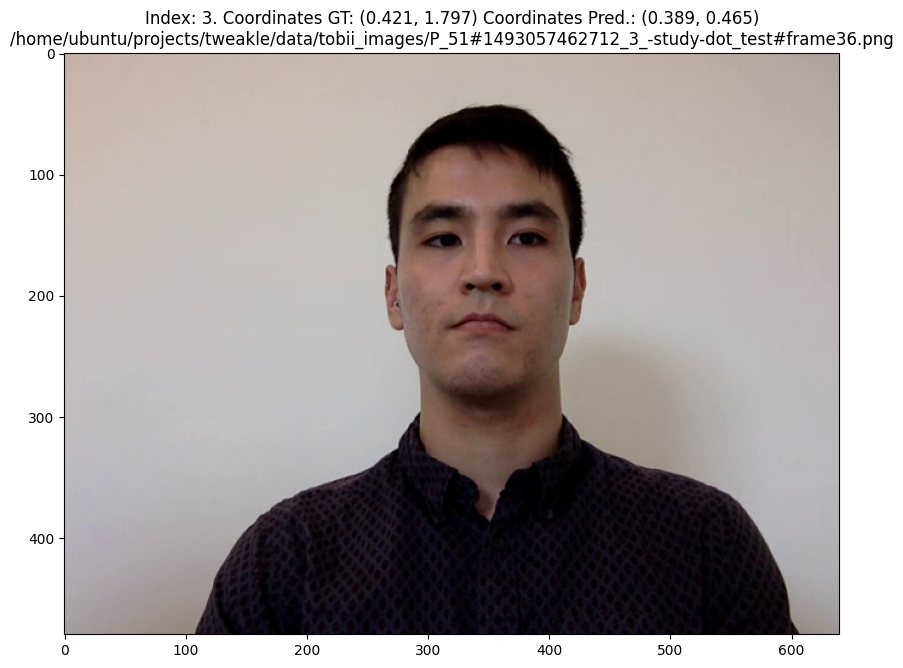

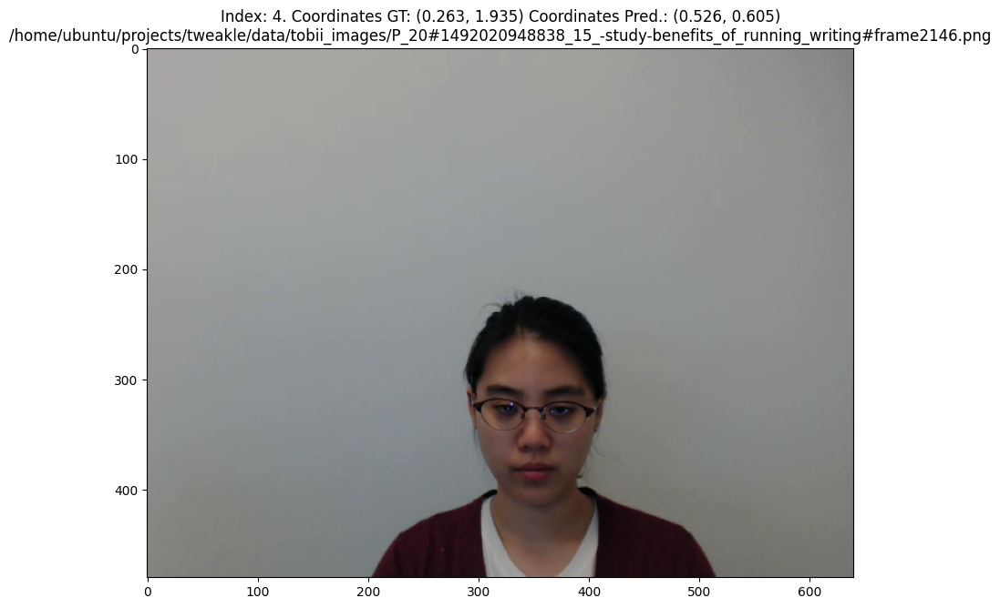

...

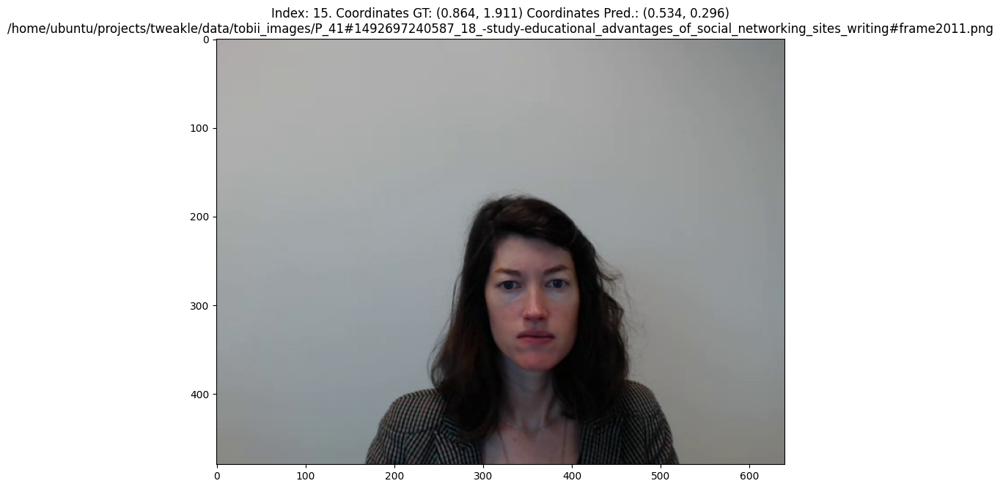

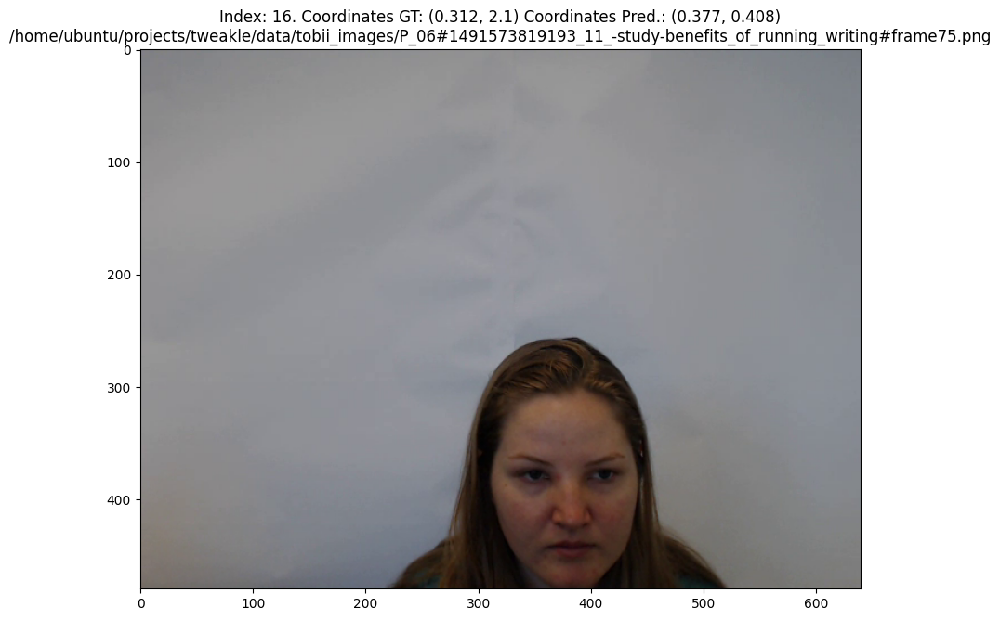

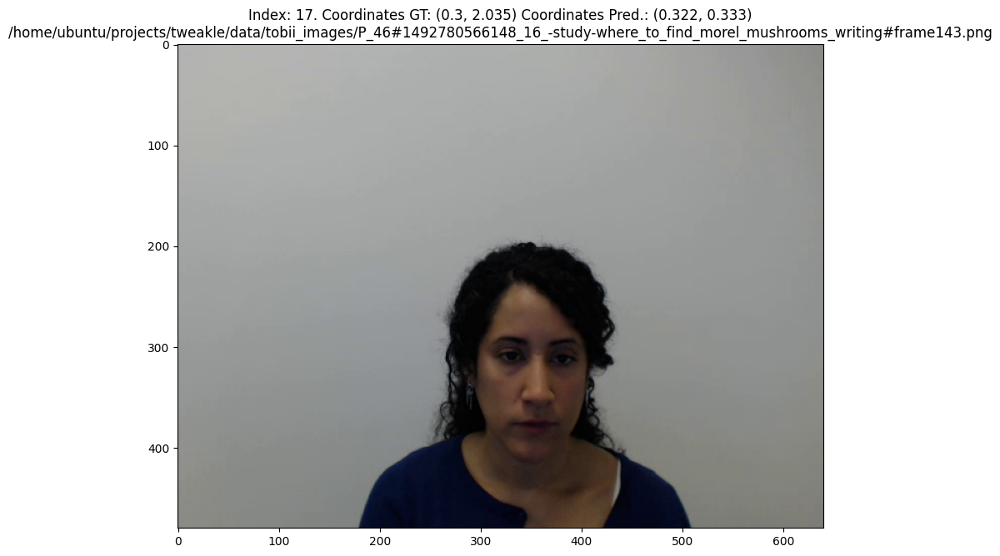

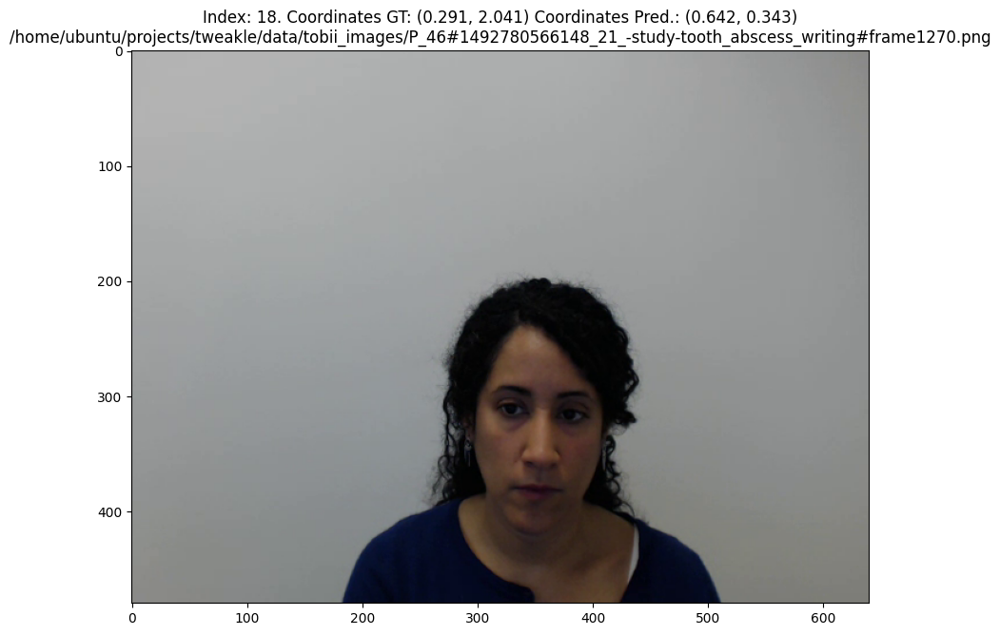

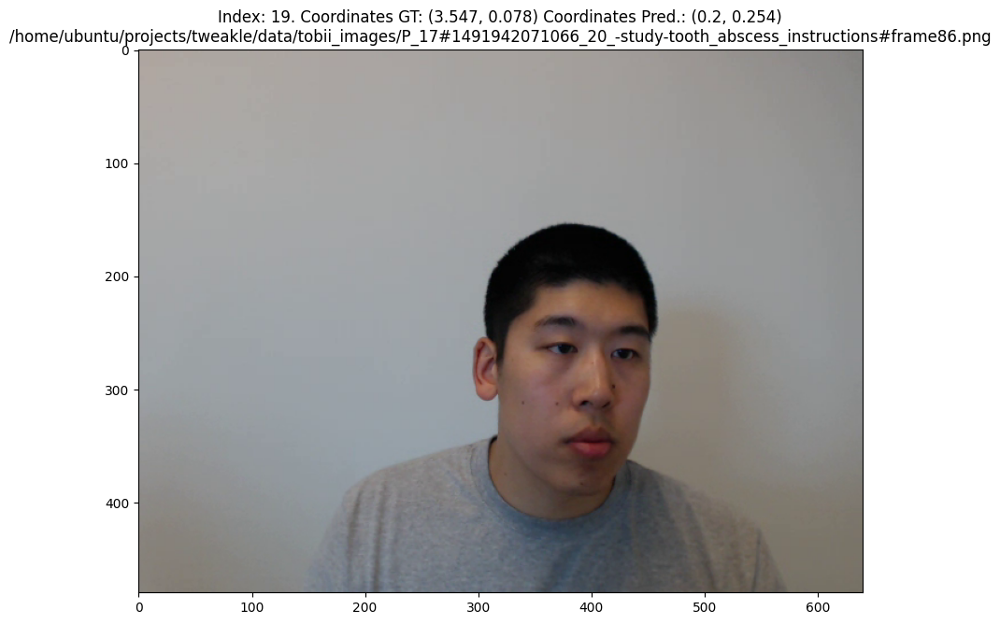

In [34]:
worst_subset = sorted_df.tail(20)
for i in range(worst_subset.shape[0]):
    row = worst_subset.iloc[i]
    path = row['paths']
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 8))
    plt.title(f'Index: {i}. Coordinates GT: ({round(row["x_normalized"],3)}, {round(row["y_normalized"],3)}) '
              f'Coordinates Pred.: ({round(row["pred_x"],3)}, {round(row["pred_y"],3)})\n{row["paths"]}')
    plt.imshow(img)
    plt.show()

There are errors in markup. Person looks in the middle of screen, y coordinate is very large

In [192]:
test_0 = sorted_df[(sorted_df["x_normalized"] < 1.2) & (sorted_df["y_normalized"] < 1.1)]

In [193]:
test.shape

(14926, 7)

In [194]:
preds = df[["pred_x", "pred_y"]].values
labels = df[["x_normalized", "y_normalized"]].values

In [195]:
mape_value = mape(labels, preds)
print(f"Test MAPE: {mape_value}")

Test MAPE: 0.5190532947712757


In [196]:
rmse_value = mse(labels, preds, squared=True)
print(f"Test RMSE: {rmse_value}")

Test RMSE: 0.026721502582325952


In [197]:
preds = test_0[["pred_x", "pred_y"]].values
labels = test_0[["x_normalized", "y_normalized"]].values

In [198]:
mape_value = mape(labels, preds)
print(f"Test MAPE: {mape_value}")

Test MAPE: 0.5218930686381421


In [199]:
rmse_value = mse(labels, preds, squared=True)
print(f"Test RMSE: {rmse_value}")

Test RMSE: 0.020894235437139995


In [200]:
sorted_df.loc[(sorted_df["y_normalized"] > 1.1) & (sorted_df["y_normalized"] <= 1.6), "y_normalized"] = 1.1

In [201]:
test = sorted_df[(sorted_df["x_normalized"] < 1.5) & (sorted_df["y_normalized"] < 1.5)]

In [202]:
preds = test[["pred_x", "pred_y"]].values
labels = test[["x_normalized", "y_normalized"]].values

In [203]:
mape_value = mape(labels, preds)
print(f"Test MAPE: {mape_value}")

Test MAPE: 0.5174889363587384


In [204]:
rmse_value = mse(labels, preds, squared=True)
print(f"Test RMSE: {rmse_value}")

Test RMSE: 0.022041434501598456


In [205]:
sorted_df_2 = test_0.sort_values("distances")

In [206]:
sorted_df_2["experiment"] = sorted_df_2["full_name"].apply(lambda x: "#".join(x.split("#")[:-1]))

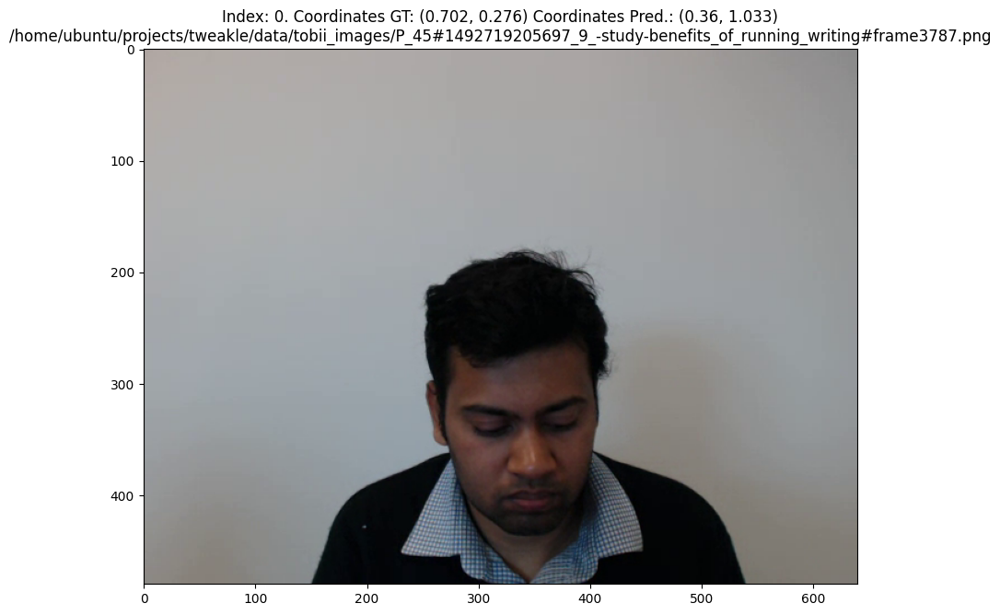

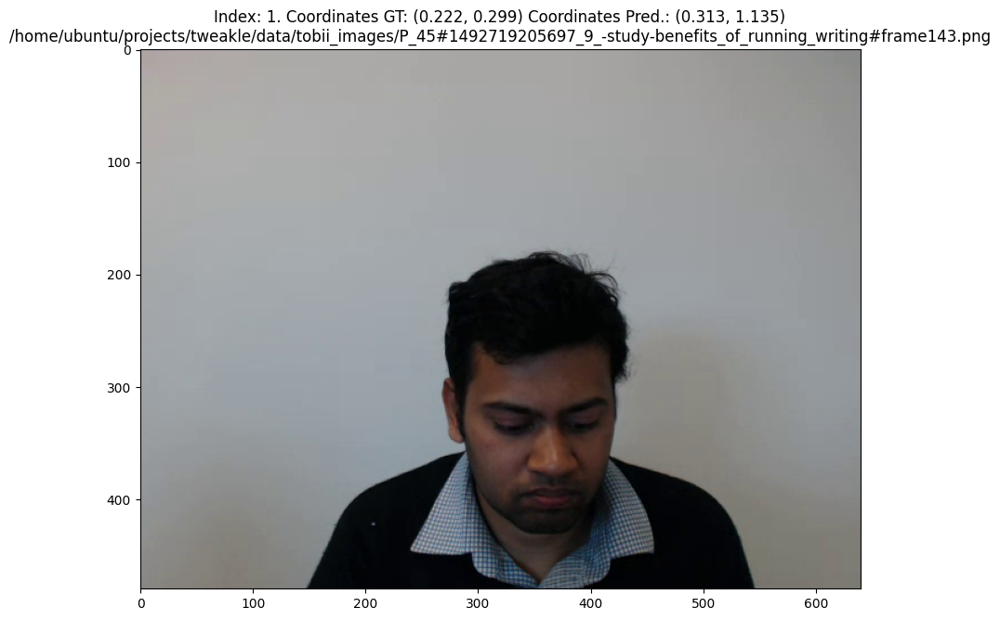

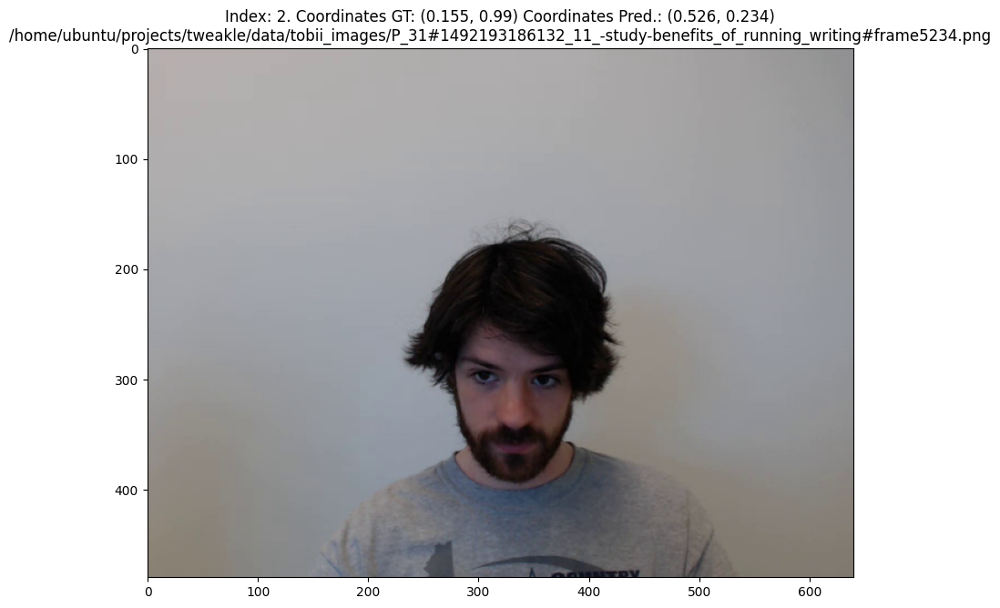

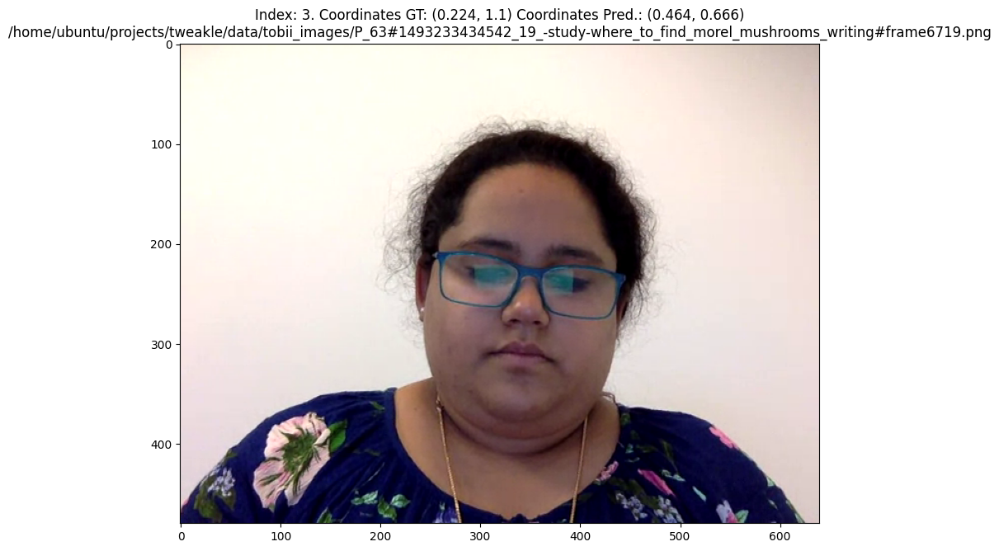

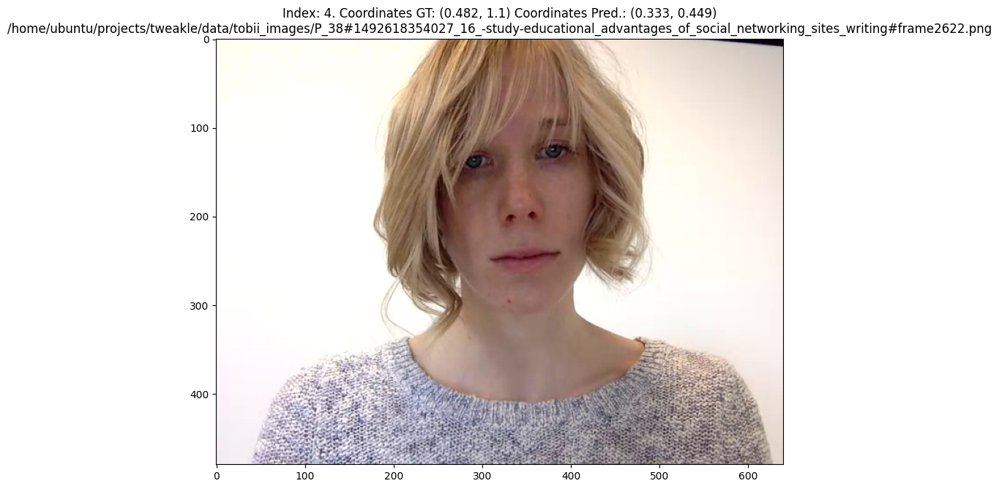

...

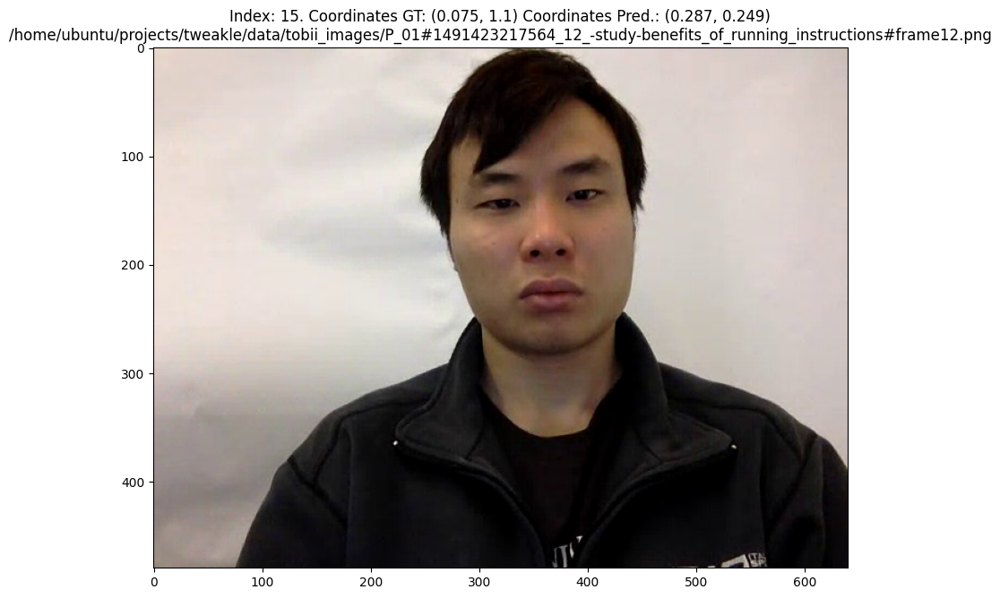

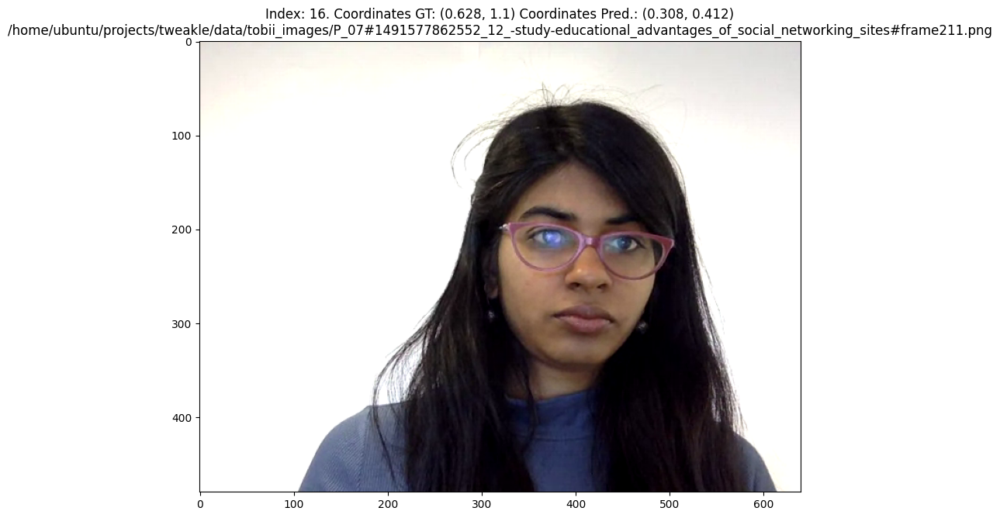

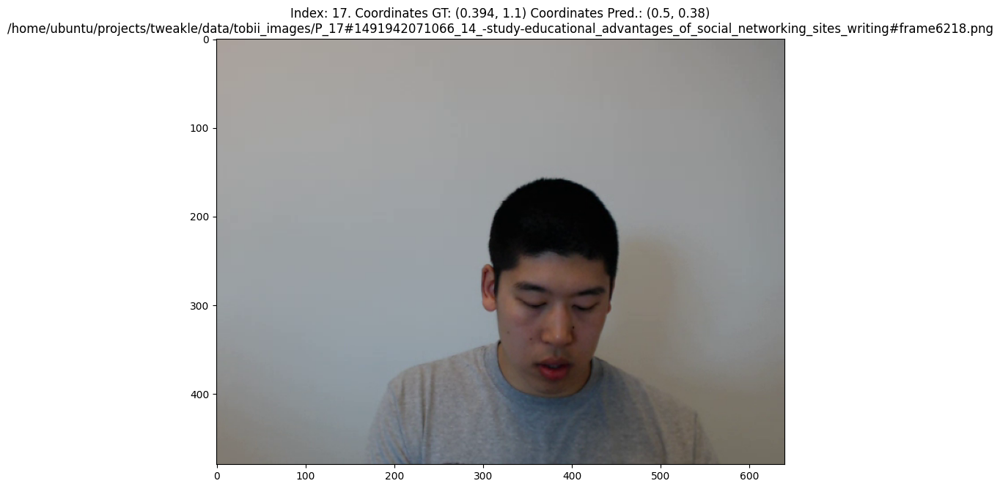

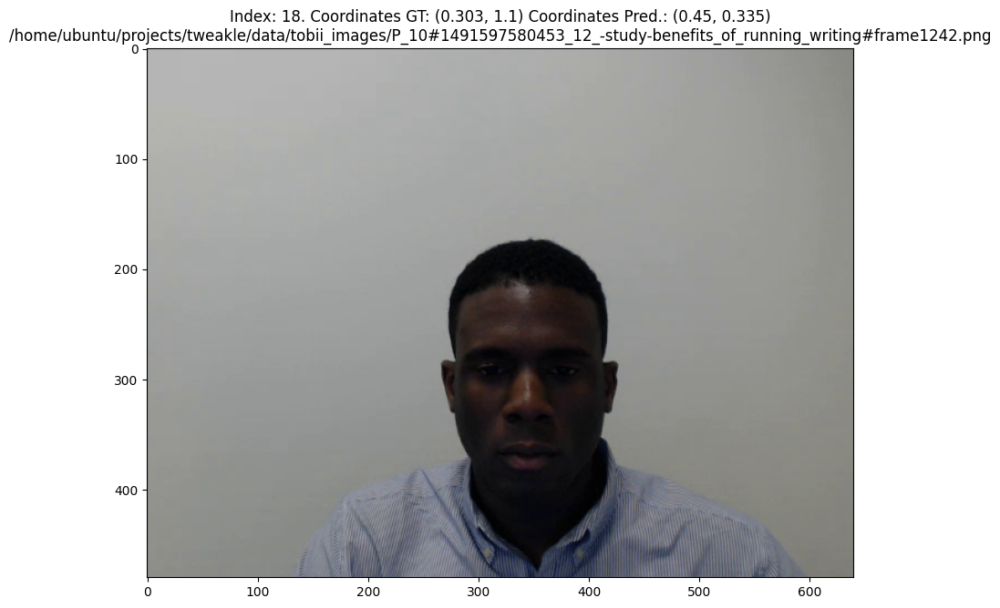

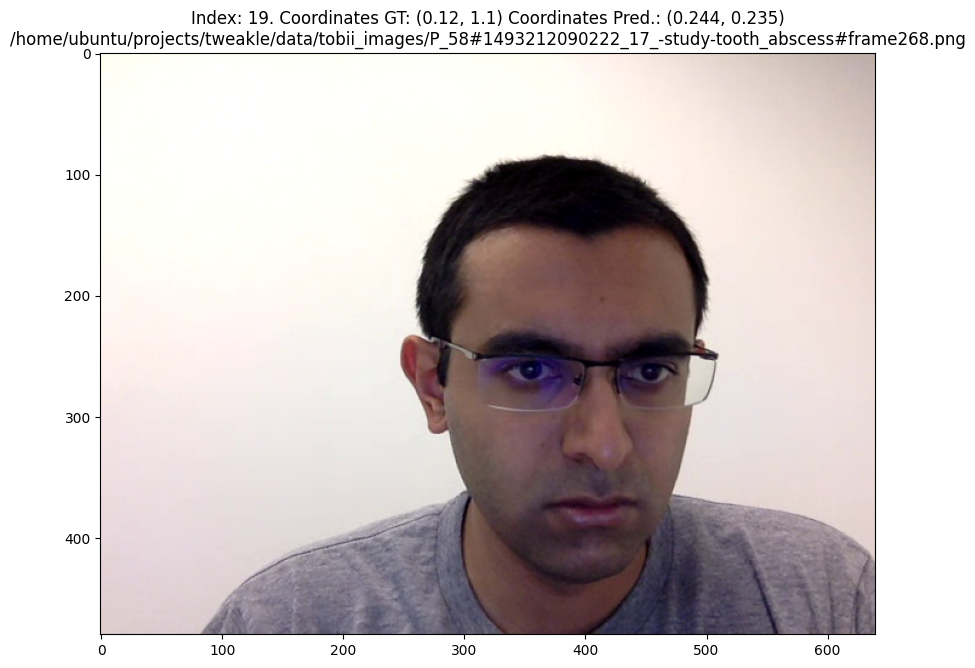

In [78]:
worst_subset = sorted_df_2.tail(20)
for i in range(worst_subset.shape[0]):
    row = worst_subset.iloc[i]
    path = row['paths']
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 8))
    plt.title(f'Index: {i}. Coordinates GT: ({round(row["x_normalized"],3)}, {round(row["y_normalized"],3)}) '
              f'Coordinates Pred.: ({round(row["pred_x"],3)}, {round(row["pred_y"],3)})\n{row["paths"]}')
    plt.imshow(img)
    plt.show()

Seems like some videos have different origin of x

In [207]:
condition = ((sorted_df_2["x_normalized"] > 0.6) & (sorted_df_2["pred_x"] < 0.4)) | \
            ((sorted_df_2["x_normalized"] < 0.4) & (sorted_df_2["pred_x"] > 0.6))
test_2 = sorted_df_2[condition].sort_values("distances")
test_2

,paths,x_normalized,y_normalized,full_name,pred_x,pred_y,distances,experiment
2694,/home/ubuntu/projects/tweakle/data/tobii_image...,0.604530,0.250806,P_08#1491591937547_11_-study-educational_advan...,0.386548,0.267553,0.218624,P_08#1491591937547_11_-study-educational_advan...
2209,/home/ubuntu/projects/tweakle/data/tobii_image...,0.379001,0.753181,P_57#1493143714690_5_-study-fitts_law#frame824...,0.606461,0.727037,0.228958,P_57#1493143714690_5_-study-fitts_law
4653,/home/ubuntu/projects/tweakle/data/tobii_image...,0.621832,0.757282,P_56#1493140407667_6_-study-serp_instructions#...,0.391527,0.754804,0.230318,P_56#1493140407667_6_-study-serp_instructions
3955,/home/ubuntu/projects/tweakle/data/tobii_image...,0.606496,0.545631,P_38#1492618354027_16_-study-educational_advan...,0.375271,0.513919,0.233389,P_38#1492618354027_16_-study-educational_advan...
14947,/home/ubuntu/projects/tweakle/data/tobii_image...,0.625213,0.352727,P_17#1491942071066_19_-study-where_to_find_mor...,0.394390,0.302700,0.236182,P_17#1491942071066_19_-study-where_to_find_mor...
...,...,...,...,...,...,...,...,...
192,/home/ubuntu/projects/tweakle/data/tobii_image...,1.011029,0.941237,P_17#1491942071066_25_-study-dot_test_final_in...,0.323941,0.480209,0.827428,P_17#1491942071066_25_-study-dot_test_final_in...
3224,/home/ubuntu/projects/tweakle/data/tobii_image...,0.702327,0.275714,P_45#1492719205697_9_-study-benefits_of_runnin...,0.360205,1.033297,0.831252,P_45#1492719205697_9_-study-benefits_of_runnin...
14777,/home/ubuntu/projects/tweakle/data/tobii_image...,0.925816,0.977023,P_10#1491597580453_9_-study-benefits_of_runnin...,0.238561,0.475651,0.850702,P_10#1491597580453_9_-study-benefits_of_running
6882,/home/ubuntu/projects/tweakle/data/tobii_image...,1.008022,0.136054,P_07#1491577862552_3_-study-dot_test#frame241.png,0.226790,0.481901,0.854362,P_07#1491577862552_3_-study-dot_test


In [208]:
test_2["experiment"].value_counts().head(10)

experiment
P_17#1491942071066_19_-study-where_to_find_morel_mushrooms_writing                        8
P_45#1492719205697_12_-study-educational_advantages_of_social_networking_sites_writing    7
P_17#1491942071066_24_-study-tooth_abscess_writing                                        7
P_20#1492020948838_15_-study-benefits_of_running_writing                                  7
P_51#1493057462712_12_-study-benefits_of_running_writing                                  6
P_24#1492106295971_16_-study-where_to_find_morel_mushrooms_writing                        6
P_46#1492780566148_13_-study-educational_advantages_of_social_networking_sites_writing    5
P_45#1492719205697_18_-study-tooth_abscess_writing                                        5
P_45#1492719205697_9_-study-benefits_of_running_writing                                   5
P_45#1492719205697_17_-study-tooth_abscess                                                4
Name: count, dtype: int64

In [209]:
exp = test_2["experiment"].value_counts().index[2]

In [210]:
sorted_df_2[sorted_df_2["experiment"] == exp]

,paths,x_normalized,y_normalized,full_name,pred_x,pred_y,distances,experiment
12728,/home/ubuntu/projects/tweakle/data/tobii_image...,0.651604,0.394107,P_17#1491942071066_24_-study-tooth_abscess_wri...,0.665194,0.380600,0.019160,P_17#1491942071066_24_-study-tooth_abscess_wri...
214,/home/ubuntu/projects/tweakle/data/tobii_image...,0.692751,0.368873,P_17#1491942071066_24_-study-tooth_abscess_wri...,0.686335,0.393145,0.025105,P_17#1491942071066_24_-study-tooth_abscess_wri...
8876,/home/ubuntu/projects/tweakle/data/tobii_image...,0.345196,0.362245,P_17#1491942071066_24_-study-tooth_abscess_wri...,0.326916,0.389496,0.032814,P_17#1491942071066_24_-study-tooth_abscess_wri...
11576,/home/ubuntu/projects/tweakle/data/tobii_image...,0.191680,0.407619,P_17#1491942071066_24_-study-tooth_abscess_wri...,0.197874,0.374826,0.033372,P_17#1491942071066_24_-study-tooth_abscess_wri...
5680,/home/ubuntu/projects/tweakle/data/tobii_image...,0.198640,0.403669,P_17#1491942071066_24_-study-tooth_abscess_wri...,0.186709,0.364149,0.041282,P_17#1491942071066_24_-study-tooth_abscess_wri...
...,...,...,...,...,...,...,...,...
1521,/home/ubuntu/projects/tweakle/data/tobii_image...,0.274418,0.378755,P_17#1491942071066_24_-study-tooth_abscess_wri...,0.708913,0.404823,0.435277,P_17#1491942071066_24_-study-tooth_abscess_wri...
13870,/home/ubuntu/projects/tweakle/data/tobii_image...,0.105360,0.052150,P_17#1491942071066_24_-study-tooth_abscess_wri...,0.487508,0.307309,0.459502,P_17#1491942071066_24_-study-tooth_abscess_wri...
11070,/home/ubuntu/projects/tweakle/data/tobii_image...,0.064440,0.403608,P_17#1491942071066_24_-study-tooth_abscess_wri...,0.550949,0.434267,0.487473,P_17#1491942071066_24_-study-tooth_abscess_wri...
2528,/home/ubuntu/projects/tweakle/data/tobii_image...,0.897175,0.388207,P_17#1491942071066_24_-study-tooth_abscess_wri...,0.404041,0.320129,0.497811,P_17#1491942071066_24_-study-tooth_abscess_wri...


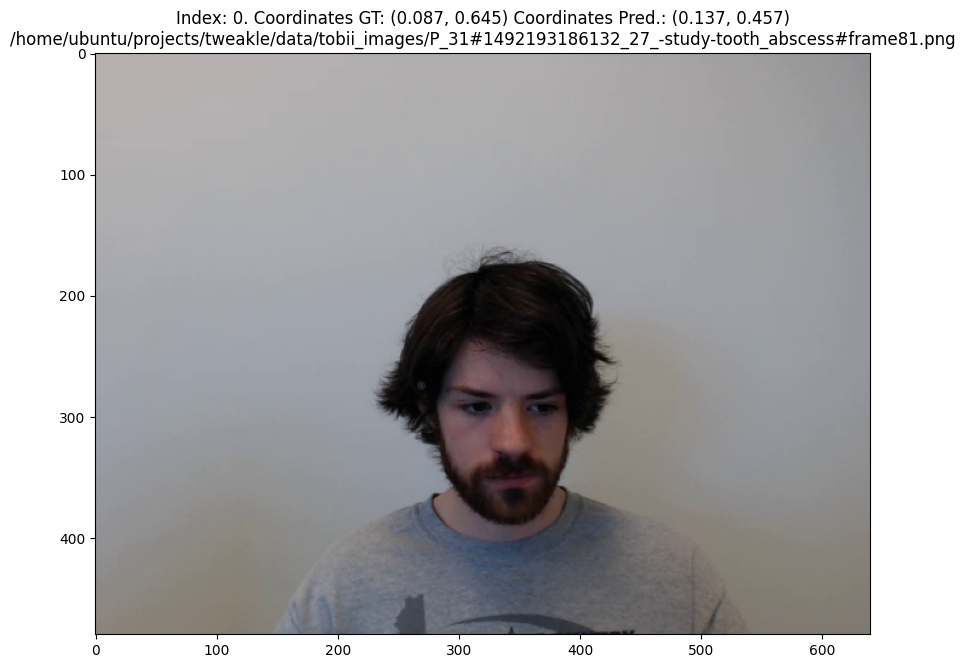

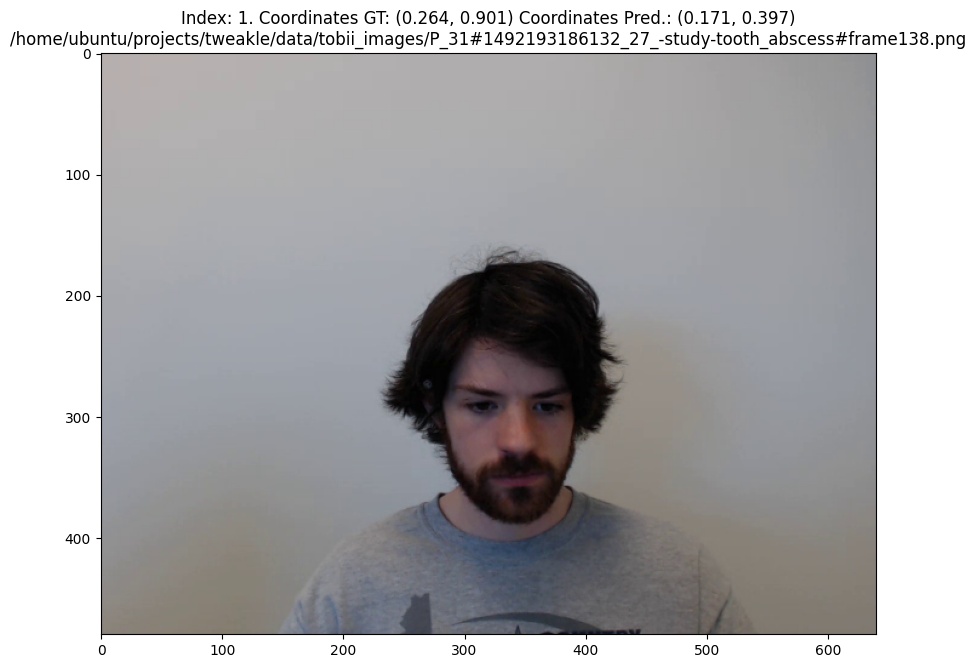

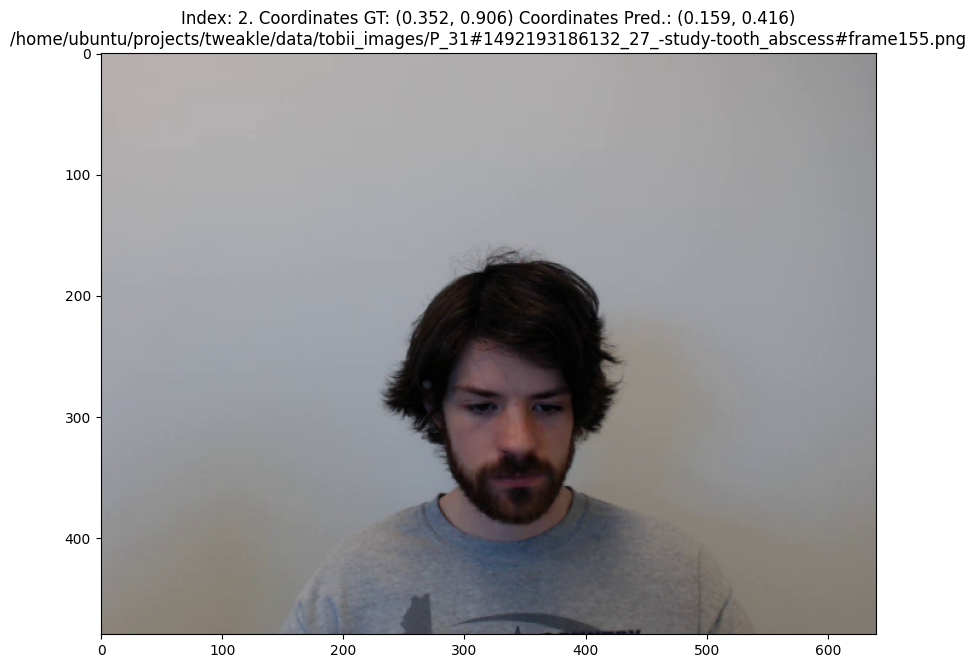

In [141]:
worst_subset = sorted_df_2[sorted_df_2["experiment"] == "P_31#1492193186132_27_-study-tooth_abscess"].tail(20)
for i in range(worst_subset.shape[0]):
    row = worst_subset.iloc[i]
    path = row['paths']
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 8))
    plt.title(f'Index: {i}. Coordinates GT: ({round(row["x_normalized"],3)}, {round(row["y_normalized"],3)}) '
              f'Coordinates Pred.: ({round(row["pred_x"],3)}, {round(row["pred_y"],3)})\n{row["paths"]}')
    plt.imshow(img)
    plt.show()

There are some users with a lot of errors in markup ?

In [211]:
sorted_df_2["uder_id"] = sorted_df_2["full_name"].apply(lambda x: x.split("#")[0])

In [212]:
sorted_df_2["uder_id"].value_counts().to_frame()

,count
uder_id,
P_46,873
P_17,795
P_45,772
P_51,704
P_10,598
P_20,583
P_59,525
P_23,502
P_08,468


In [213]:
sorted_df_2.groupby("uder_id")["distances"].mean().to_frame().sort_values("distances")

,distances
uder_id,
P_10,0.126131
P_35,0.128076
P_40,0.128847
P_25,0.130379
P_41,0.133046
P_46,0.137979
P_47,0.139628
P_16,0.141876
P_13,0.147408


There are some studies with alot of errors?

In [135]:
sorted_df_2.groupby("experiment")["distances"].mean().to_frame().sort_values("distances").tail(20)

,distances
experiment,
P_31#1492193186132_27_-study-tooth_abscess,0.410866
P_58#1493212090222_6_-study-serp_instructions,0.413455
P_53#1493126370426_18_-study-where_to_find_morel_mushrooms_writing,0.413482
P_27#1492178671950_3_-study-dot_test,0.415098
P_58#1493212090222_10_-study-educational_advantages_of_social_networking_sites_instructions,0.419129
P_58#1493212090222_18_-study-tooth_abscess_writing,0.422696
P_29#1492189262993_15_-study-educational_advantages_of_social_networking_sites_instructions,0.432656
P_39#1492629177607_3_-study-dot_test,0.436146
P_63#1493233434542_3_-study-dot_test,0.440637


In [90]:
# condition = ((sorted_df_2["x_normalized"] > 0.6) & (sorted_df_2["pred_x"] < 0.4)) | \
#             ((sorted_df_2["x_normalized"] < 0.4) & (sorted_df_2["pred_x"] > 0.6))
# sorted_df_2.loc[condition, "x_normalized"] = 1 - sorted_df_2.loc[condition, "x_normalized"] 

In [214]:
condition = ((sorted_df_2["x_normalized"] > 0.6) & (sorted_df_2["pred_x"] < 0.4)) | \
            ((sorted_df_2["x_normalized"] < 0.4) & (sorted_df_2["pred_x"] > 0.6))
test_ = sorted_df_2[~condition]

In [215]:
preds = test_[["pred_x", "pred_y"]].values
labels = test_[["x_normalized", "y_normalized"]].values

In [216]:
mape_value = mape(labels, preds)
print(f"Test MAPE: {mape_value}")

Test MAPE: 0.5172852155224819


In [217]:
rmse_value = mse(labels, preds, squared=True)
print(f"Test RMSE: {rmse_value}")

Test RMSE: 0.01930542088035865


In [144]:
test_.tail(40)

,paths,x_normalized,y_normalized,full_name,pred_x,pred_y,distances
10753,/home/ubuntu/projects/tweakle/data/tobii_image...,0.410406,1.100000,P_24#1492106295971_19_-study-tooth_abscess_wri...,0.428120,0.482346,0.729705
14610,/home/ubuntu/projects/tweakle/data/tobii_image...,0.400182,1.100000,P_52#1493064746365_12_-study-benefits_of_runni...,0.456323,0.530103,0.732568
11523,/home/ubuntu/projects/tweakle/data/tobii_image...,0.053544,0.933787,P_56#1493140407667_8_-study-benefits_of_runnin...,0.468007,0.329018,0.733161
14952,/home/ubuntu/projects/tweakle/data/tobii_image...,0.438238,1.100000,P_02#1491487691210_17_-study-educational_advan...,0.504937,0.630413,0.733265
10991,/home/ubuntu/projects/tweakle/data/tobii_image...,0.037203,0.928055,P_16#1491937688450_13_-study-educational_advan...,0.478801,0.341845,0.733928
8412,/home/ubuntu/projects/tweakle/data/tobii_image...,0.472728,1.100000,P_29#1492189262993_20_-study-educational_advan...,0.280892,0.702336,0.734567
1173,/home/ubuntu/projects/tweakle/data/tobii_image...,0.437268,1.100000,P_57#1493143714690_24_-study-where_to_find_mor...,0.368487,0.529651,0.735816
12710,/home/ubuntu/projects/tweakle/data/tobii_image...,0.380710,1.100000,P_38#1492618354027_10_-study-benefits_of_runni...,0.313716,0.582042,0.736619
14008,/home/ubuntu/projects/tweakle/data/tobii_image...,0.321360,1.100000,P_58#1493212090222_18_-study-tooth_abscess_wri...,0.294959,0.526122,0.738144
1682,/home/ubuntu/projects/tweakle/data/tobii_image...,0.513075,1.100000,P_51#1493057462712_20_-study-educational_advan...,0.412797,0.485358,0.753044


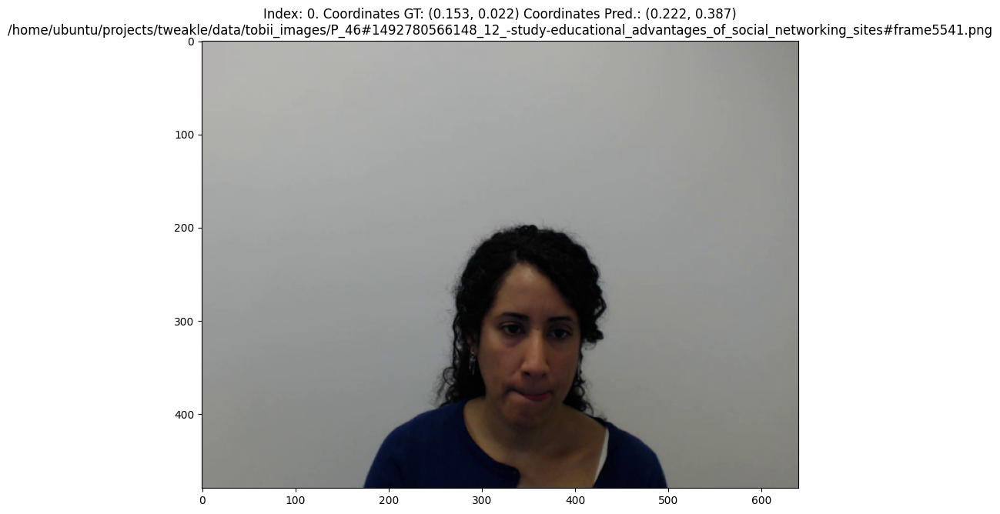

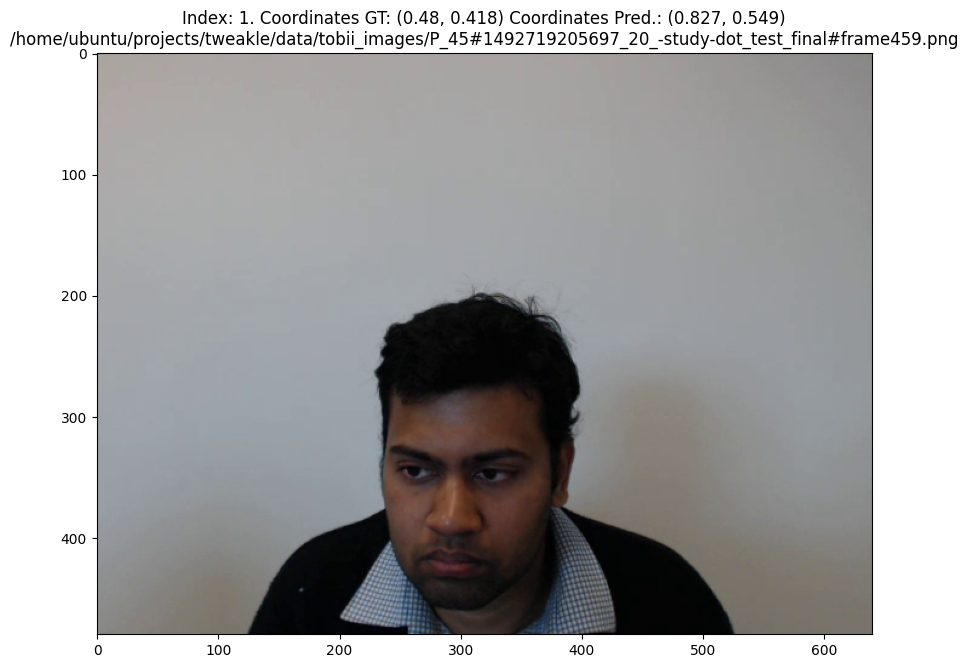

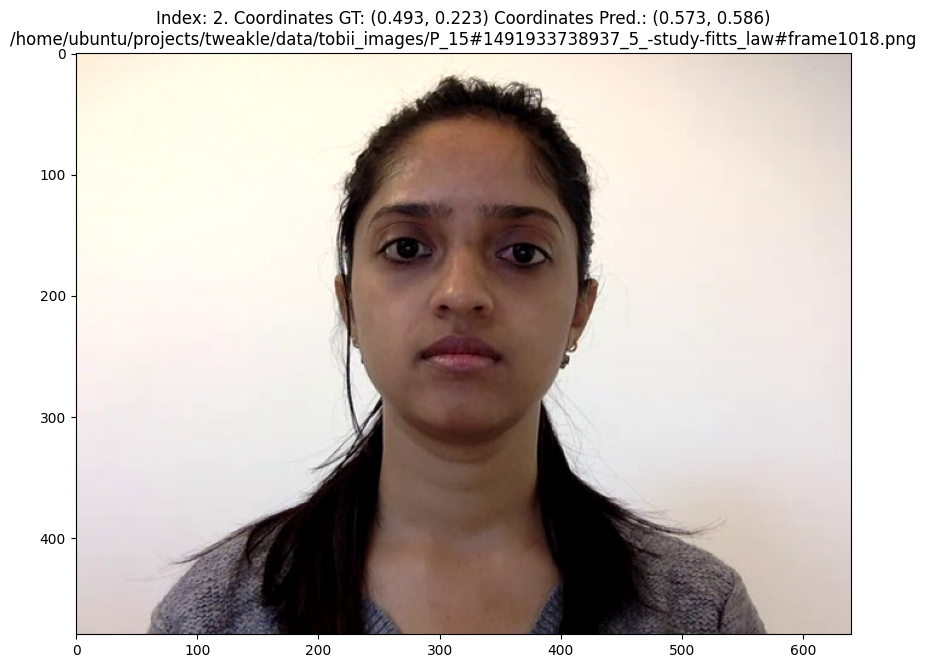

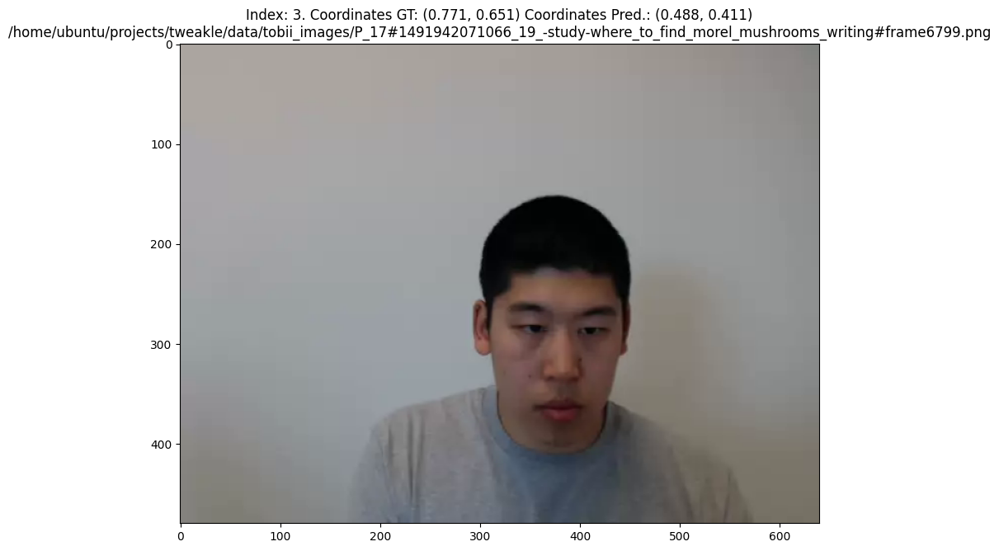

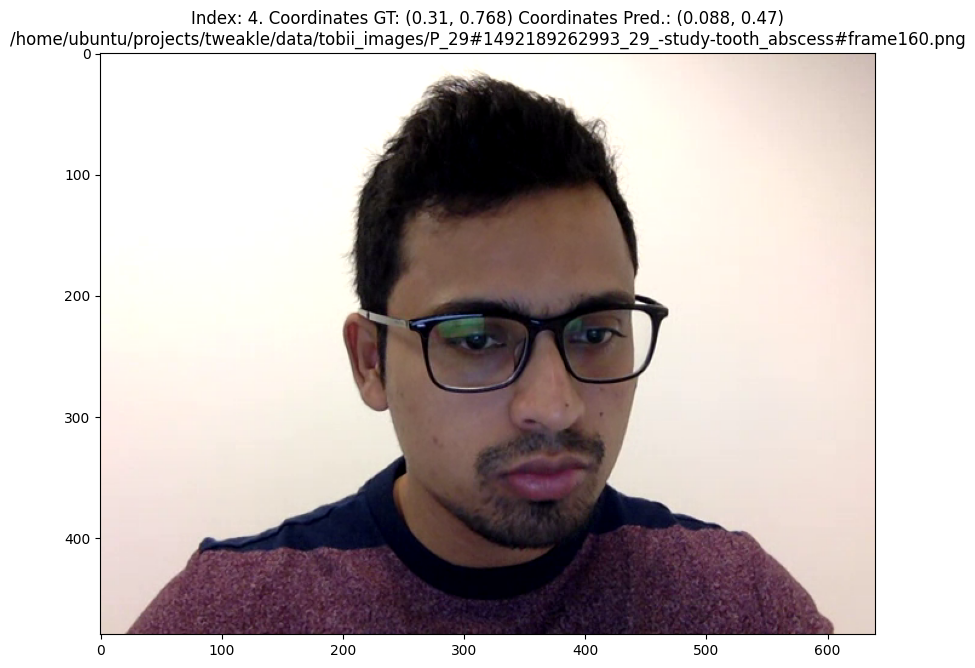

...

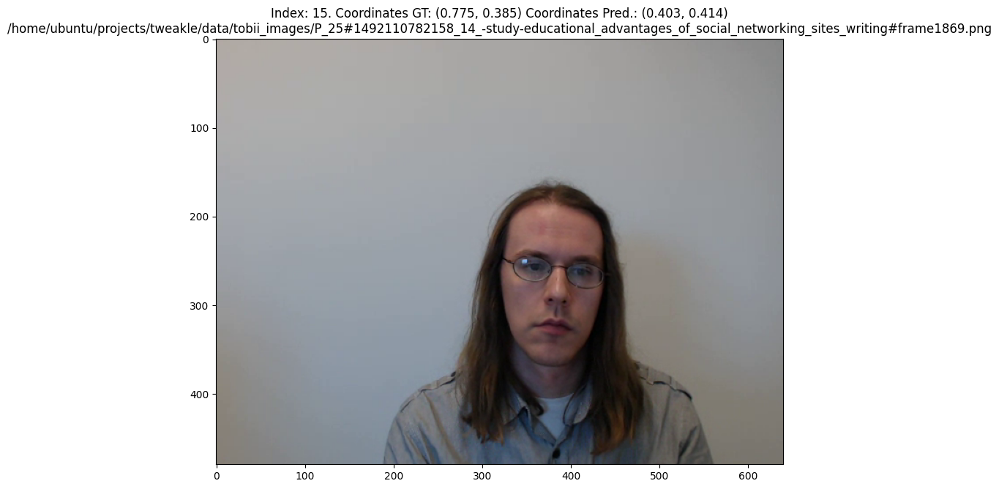

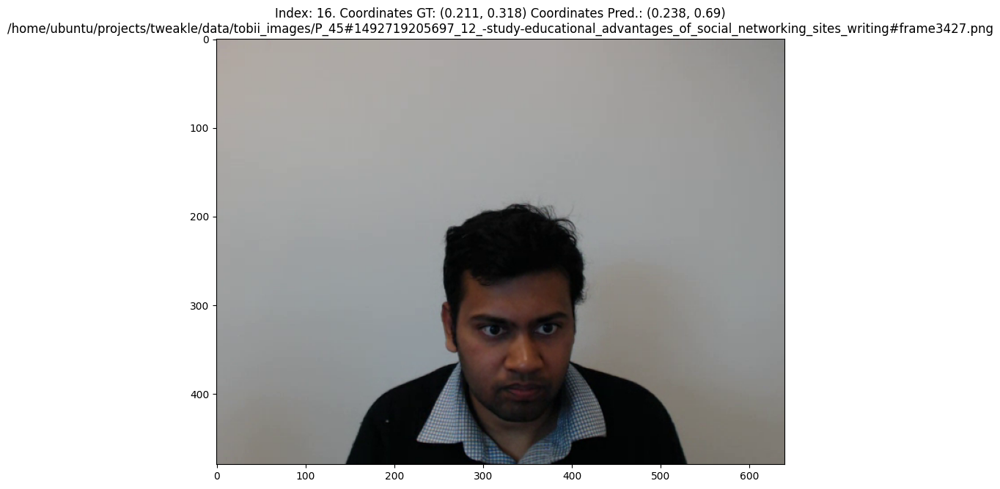

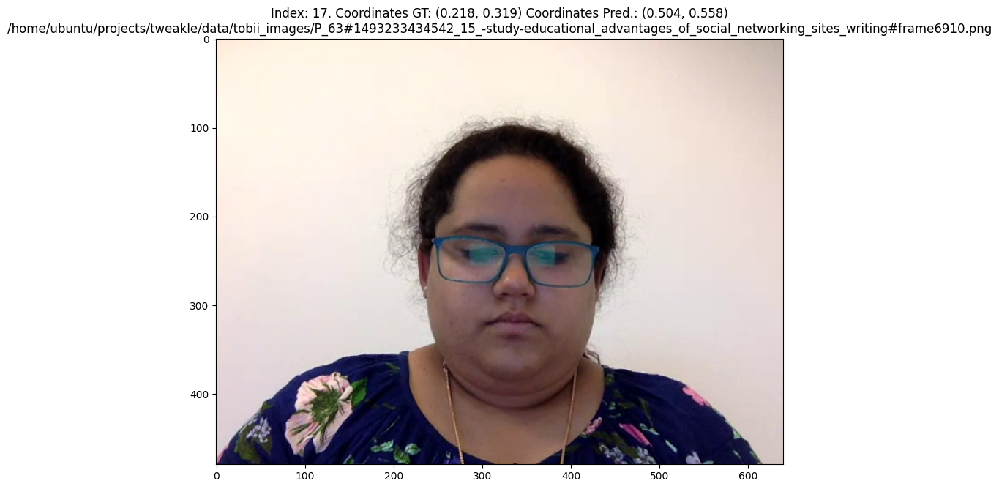

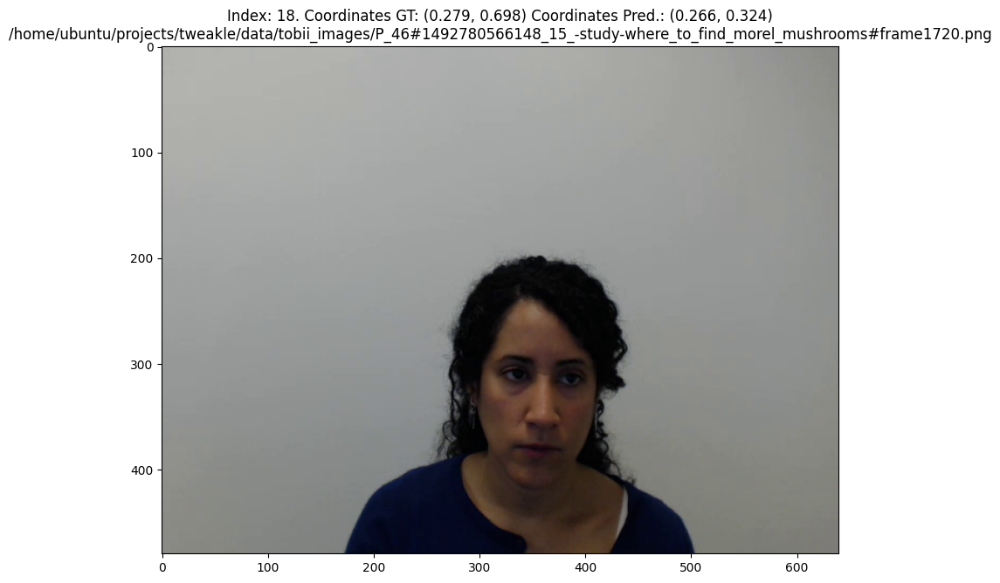

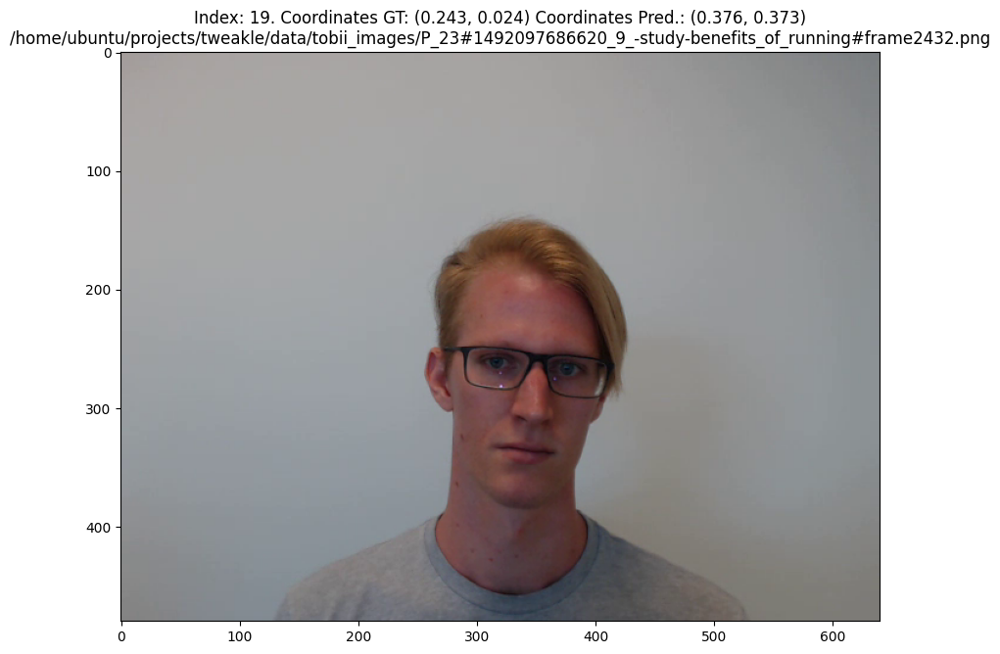

In [151]:
worst_subset = test_.iloc[-1000:-980]
for i in range(worst_subset.shape[0]):
    row = worst_subset.iloc[i]
    path = row['paths']
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 8))
    plt.title(f'Index: {i}. Coordinates GT: ({round(row["x_normalized"],3)}, {round(row["y_normalized"],3)}) '
              f'Coordinates Pred.: ({round(row["pred_x"],3)}, {round(row["pred_y"],3)})\n{row["paths"]}')
    plt.imshow(img)
    plt.show()

Still a lot of errors in markup with high values of y, but they do not have impact in quality

In [146]:
test__ = test_[test_["y_normalized"] != 1.1]

In [160]:
preds = test__[["pred_x", "pred_y"]].values
labels = test__[["x_normalized", "y_normalized"]].values

In [161]:
mape_value = mape(labels, preds)
print(f"Test MAPE: {mape_value}")

Test MAPE: 0.5172852155224819


In [162]:
rmse_value = mse(labels, preds, squared=True)
print(f"Test MSE: {rmse_value}")

Test MSE: 0.01930542088035865


**Results**:
1. Delete all the samples with `x_normalized > 1.2` and `y_normalized > 1.1`
2. Delete all the samples with opposite values in predictions and target for `x` coordinate

### Selecting golden test subset

In [258]:
random_indices = np.random.randint(0, test__.shape[0] - 1, 20)

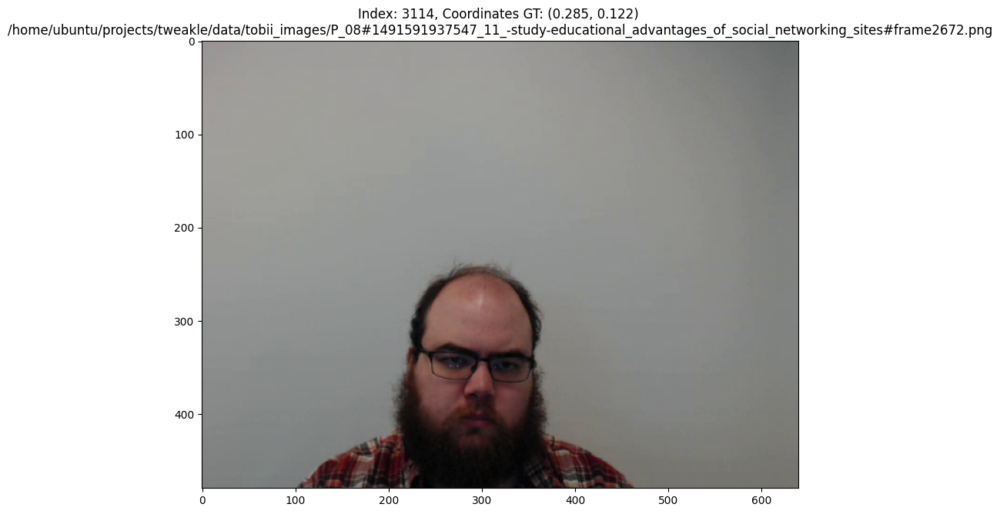

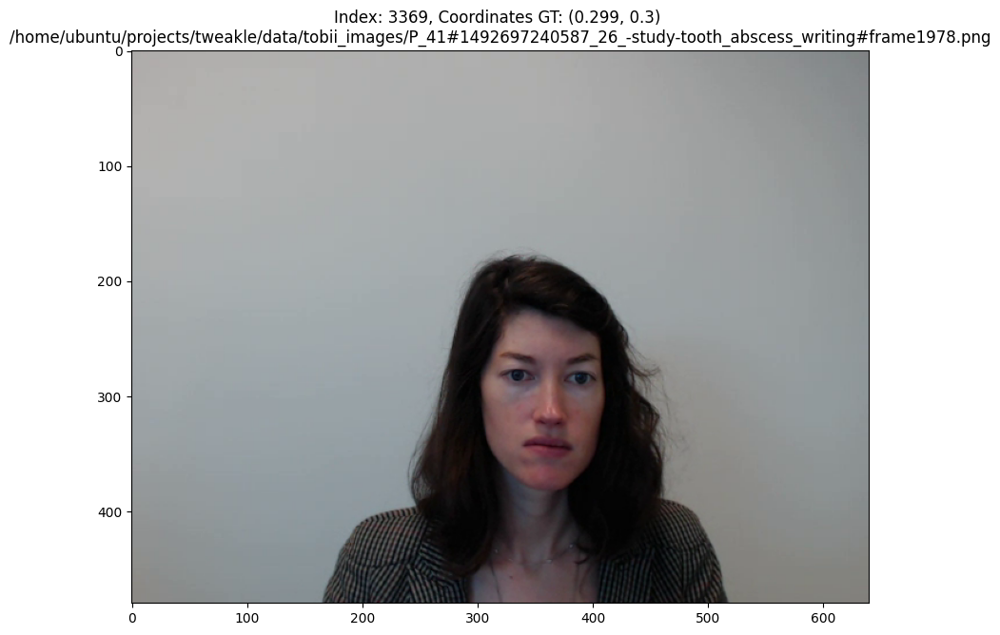

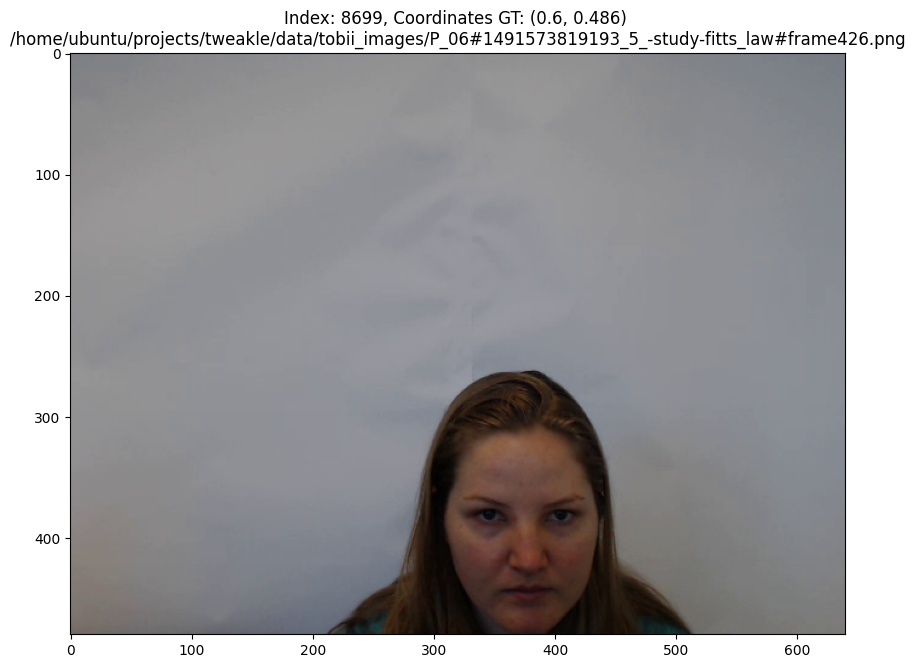

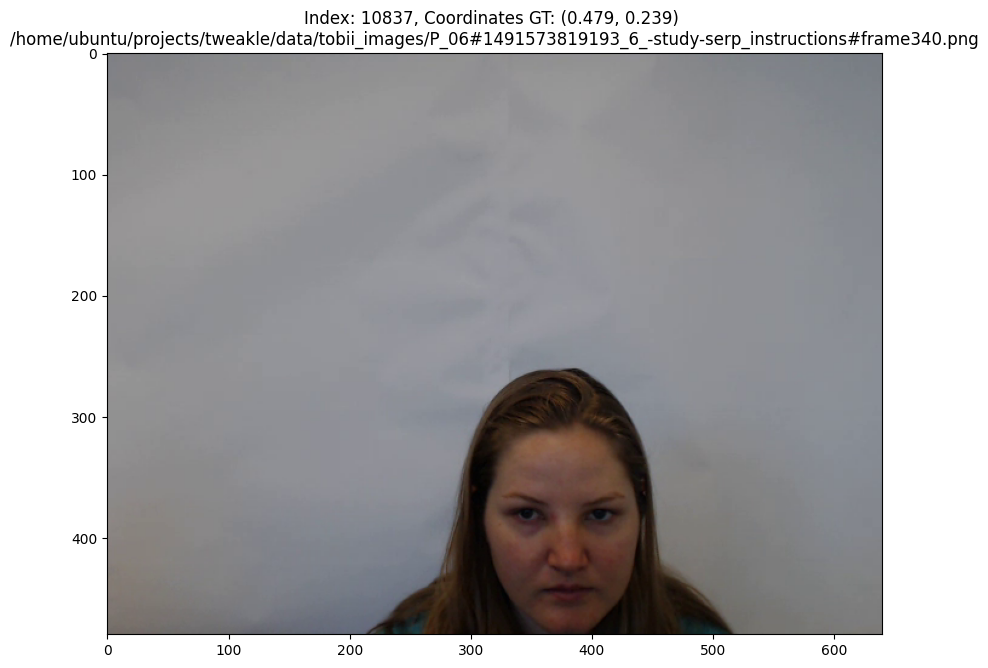

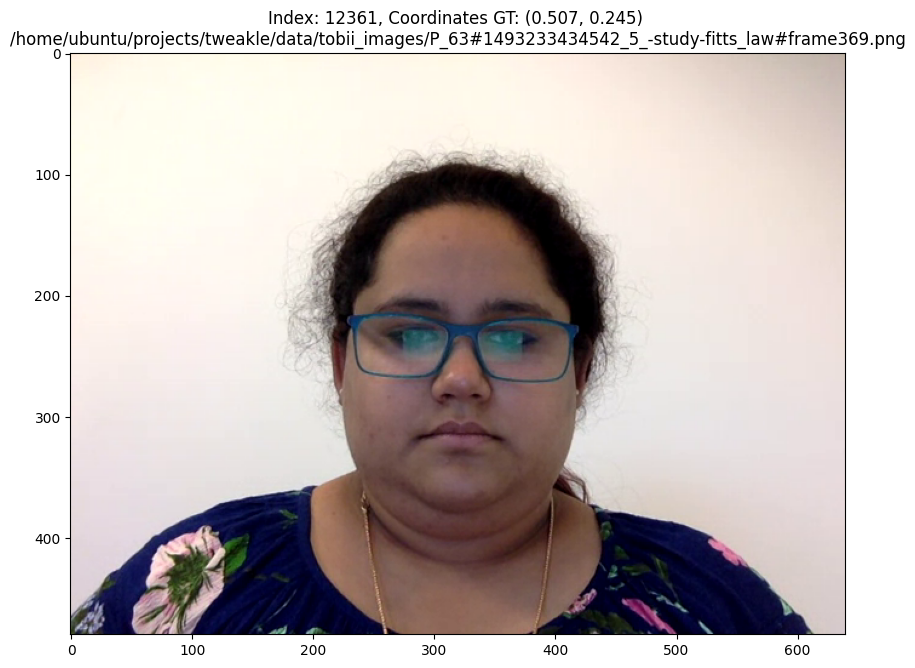

...

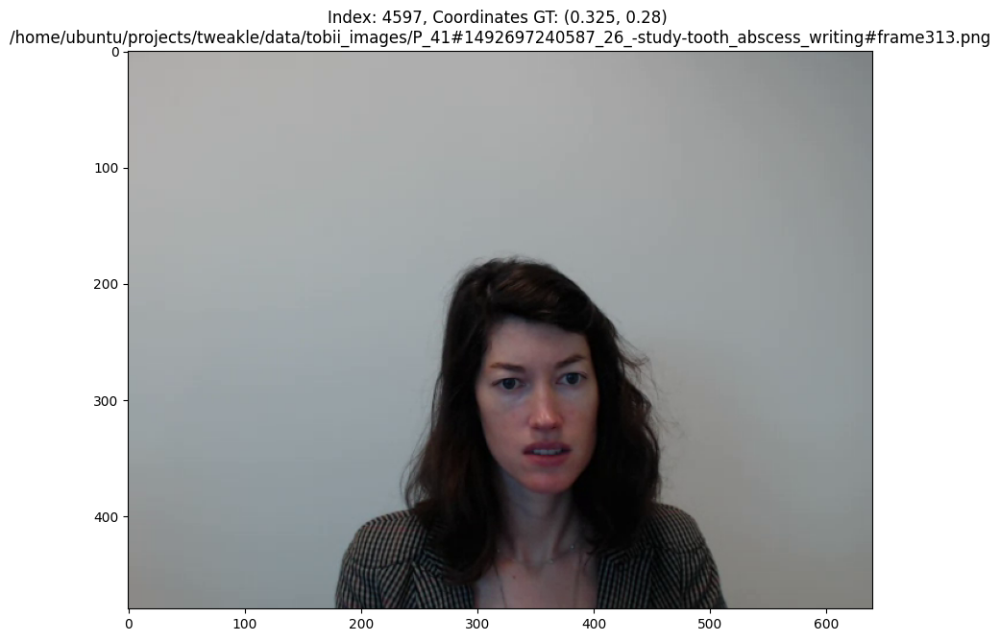

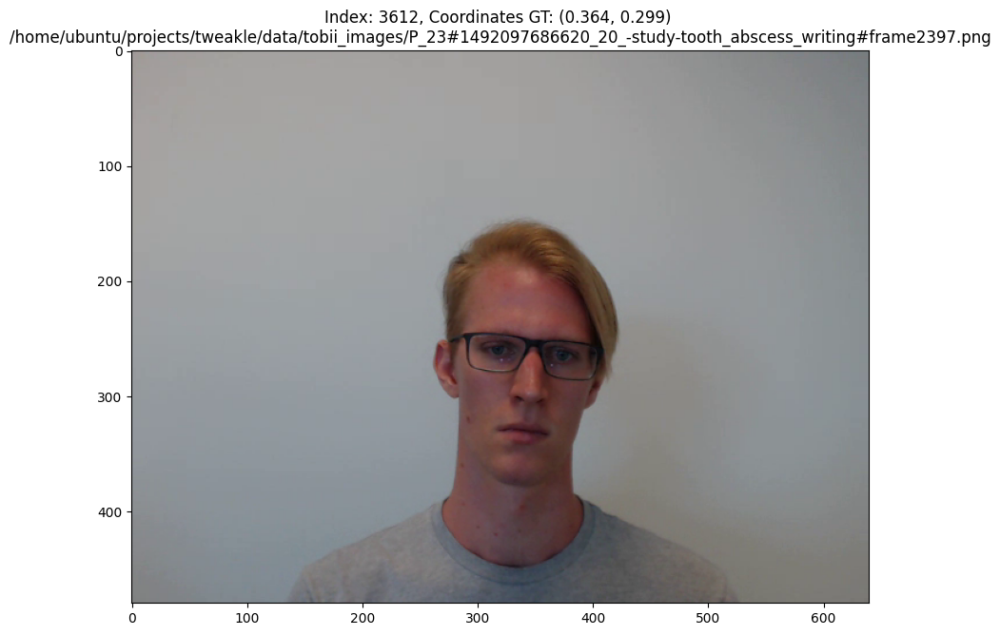

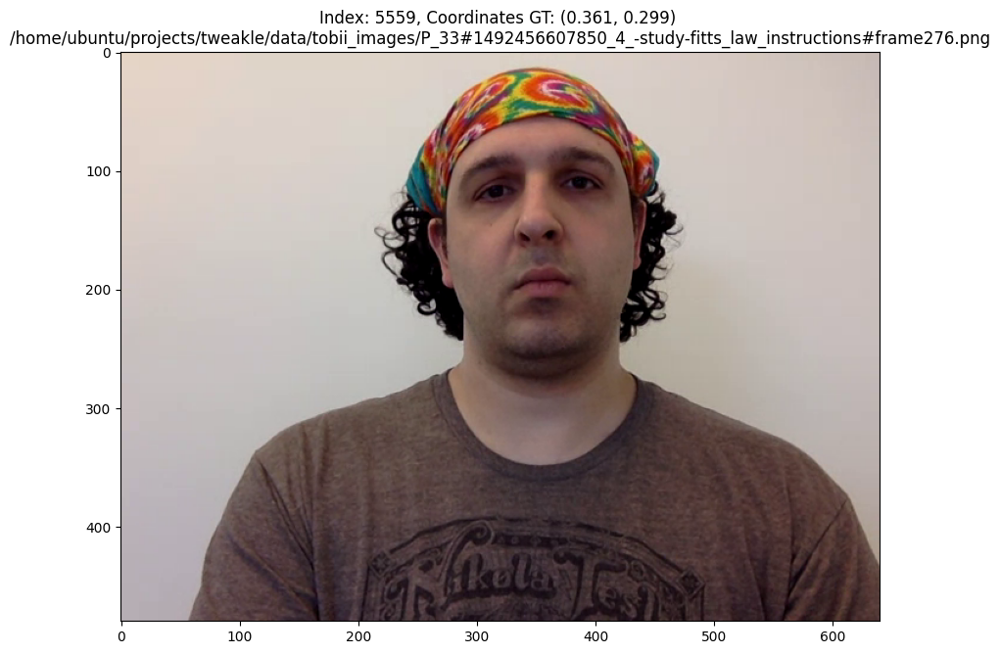

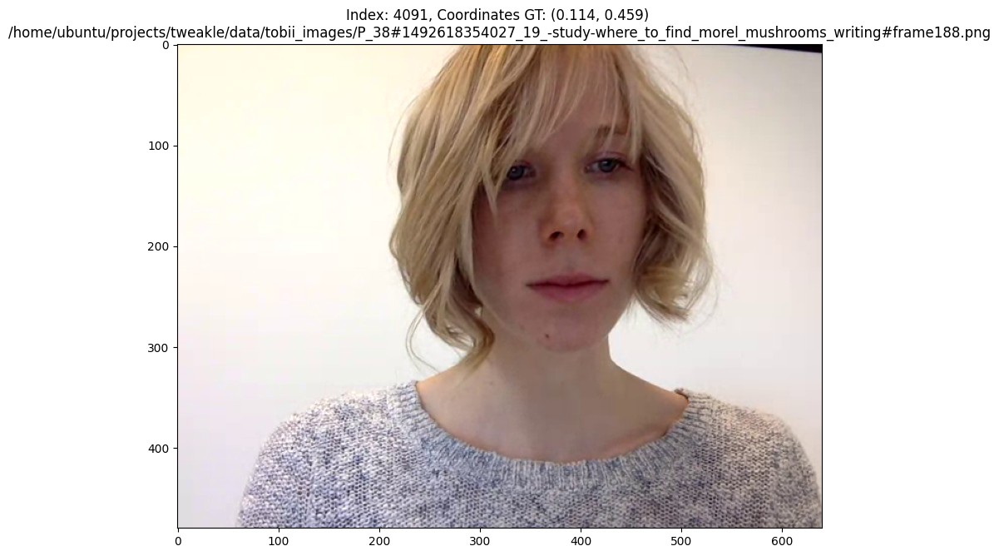

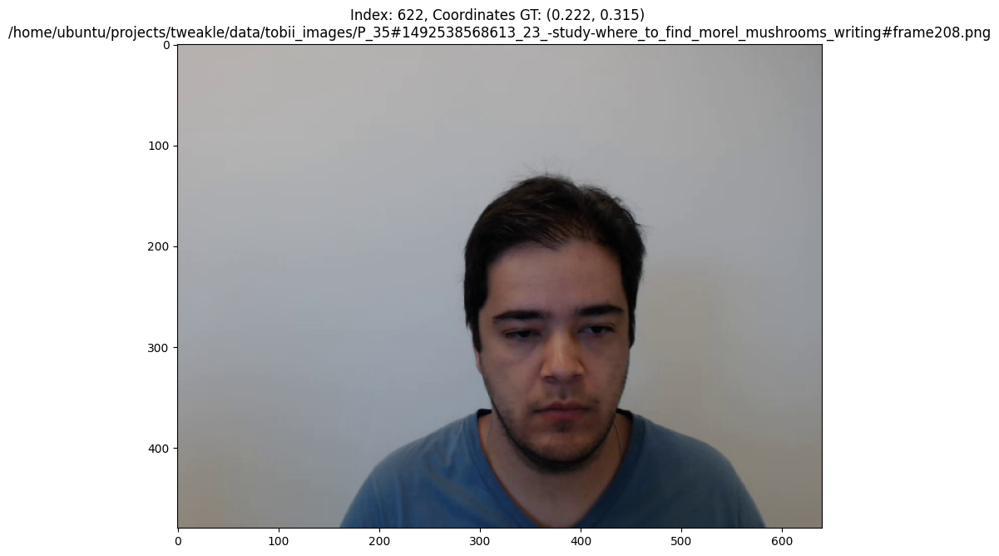

In [259]:
for i in random_indices:
    row = test__.iloc[i]
    path = row['paths']
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 8))
    plt.title(f'Index: {i}, Coordinates GT: ({round(row["x_normalized"],3)}, {round(row["y_normalized"],3)}) '
              f'\n{row["paths"]}')
    plt.imshow(img)
    plt.show()

In [223]:
test__[test__.y_normalized >= 1.1]

,paths,x_normalized,y_normalized,full_name,pred_x,pred_y,distances


In [224]:
test__

,paths,x_normalized,y_normalized,full_name,pred_x,pred_y,distances
3168,/home/ubuntu/projects/tweakle/data/tobii_image...,0.381838,0.306108,P_13#1491923431229_21_-study-educational_advan...,0.381741,0.306577,0.000479
7200,/home/ubuntu/projects/tweakle/data/tobii_image...,0.243333,0.427818,P_25#1492110782158_14_-study-educational_advan...,0.243258,0.427323,0.000500
647,/home/ubuntu/projects/tweakle/data/tobii_image...,0.436905,0.591243,P_56#1493140407667_8_-study-benefits_of_runnin...,0.437479,0.590553,0.000898
1959,/home/ubuntu/projects/tweakle/data/tobii_image...,0.298934,0.390371,P_31#1492193186132_16_-study-educational_advan...,0.297609,0.390481,0.001330
11708,/home/ubuntu/projects/tweakle/data/tobii_image...,0.503740,0.343959,P_20#1492020948838_15_-study-benefits_of_runni...,0.504660,0.342742,0.001525
...,...,...,...,...,...,...,...
11554,/home/ubuntu/projects/tweakle/data/tobii_image...,0.556624,0.307101,P_45#1492719205697_9_-study-benefits_of_runnin...,0.416000,1.084992,0.790500
1348,/home/ubuntu/projects/tweakle/data/tobii_image...,0.210487,0.290000,P_45#1492719205697_9_-study-benefits_of_runnin...,0.332427,1.094875,0.814059
551,/home/ubuntu/projects/tweakle/data/tobii_image...,0.222343,0.299269,P_45#1492719205697_9_-study-benefits_of_runnin...,0.312966,1.134793,0.840425
4224,/home/ubuntu/projects/tweakle/data/tobii_image...,0.155376,0.990458,P_31#1492193186132_11_-study-benefits_of_runni...,0.526386,0.233860,0.842667


In [225]:
test__.drop(columns = ["pred_x", "pred_y", "distances"]).to_csv("./tobii_test_sub_updv2.csv", index = False)

In [267]:
inds_selected = np.unique([
    8748,11841,7252,11168,5152,5682,7665,9840,7602,11999,2231,9161,445,1595,6315,10539,10529,1526,14096,9252,5098,12736,14197,
    4211,7861,12509,12817,9602,6351,1622,306,2158,8272,2211,10644,6982,12117,10253,10113,6446,10358,10243,750,3989,13357,5201,
    775,9296,2312,3022,4451,4926,10241,7593,5124,12051,8998,4112,10071,7092,13848,11561,6435,218,12842,3856,11268,6062,8357,204,
    10731,120,12593,6277,13912,13433,12209,7750,12823,4119,4683,10837,11974,4012,6919,10331,4841,8699,2703,12651, 9560,4597,3612,5559
])

In [268]:
golden_test = test__.iloc[inds_selected]

In [275]:
golden_test.drop(columns = ["pred_x", "pred_y", "distances"]).to_csv("./golden_test.csv", index = False)

In [269]:
preds = golden_test[["pred_x", "pred_y"]].values
labels = golden_test[["x_normalized", "y_normalized"]].values

In [270]:
mape_value = mape(labels, preds)
print(f"Test MAPE: {mape_value}")

Test MAPE: 0.49818854778427435


In [271]:
rmse_value = mse(labels, preds, squared=True)
print(f"Test MSE: {rmse_value}")

Test MSE: 0.019256499566699878


In [273]:
golden_test.sort_values("distances")

,paths,x_normalized,y_normalized,full_name,pred_x,pred_y,distances
3672,/home/ubuntu/projects/tweakle/data/tobii_image...,0.598757,0.518103,P_01#1491423217564_24_-study-educational_advan...,0.603588,0.529984,0.012825
5921,/home/ubuntu/projects/tweakle/data/tobii_image...,0.402078,0.268692,P_40#1492693878775_11_-study-benefits_of_runni...,0.409080,0.283308,0.016207
9951,/home/ubuntu/projects/tweakle/data/tobii_image...,0.599925,0.324928,P_41#1492697240587_11_-study-benefits_of_runni...,0.616706,0.325558,0.016793
2956,/home/ubuntu/projects/tweakle/data/tobii_image...,0.432601,0.485078,P_51#1493057462712_26_-study-where_to_find_mor...,0.441851,0.502769,0.019963
8056,/home/ubuntu/projects/tweakle/data/tobii_image...,0.627458,0.533012,P_38#1492618354027_10_-study-benefits_of_runni...,0.603360,0.533523,0.024103
...,...,...,...,...,...,...,...
11869,/home/ubuntu/projects/tweakle/data/tobii_image...,0.748762,0.666335,P_50#1493046335268_23_-study-tooth_abscess#fra...,0.433839,0.503322,0.354612
8180,/home/ubuntu/projects/tweakle/data/tobii_image...,0.437979,0.135651,P_58#1493212090222_10_-study-educational_advan...,0.187469,0.471677,0.419129
1290,/home/ubuntu/projects/tweakle/data/tobii_image...,0.097016,0.034285,P_52#1493064746365_10_-study-benefits_of_runni...,0.335947,0.401651,0.438230
11247,/home/ubuntu/projects/tweakle/data/tobii_image...,0.996164,0.252450,P_63#1493233434542_3_-study-dot_test#frame160.png,0.530263,0.413594,0.492982


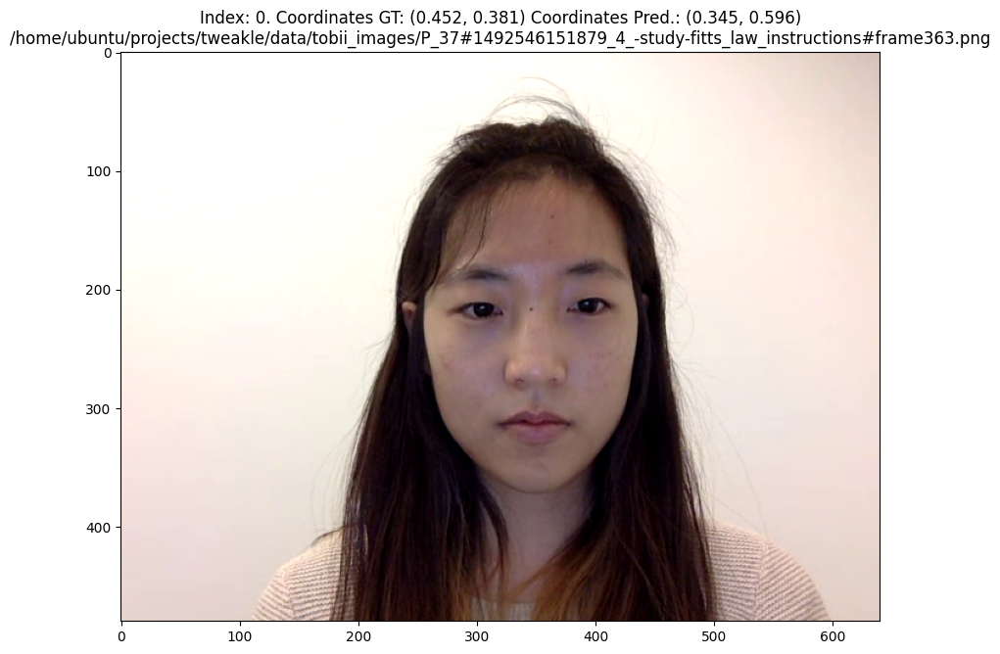

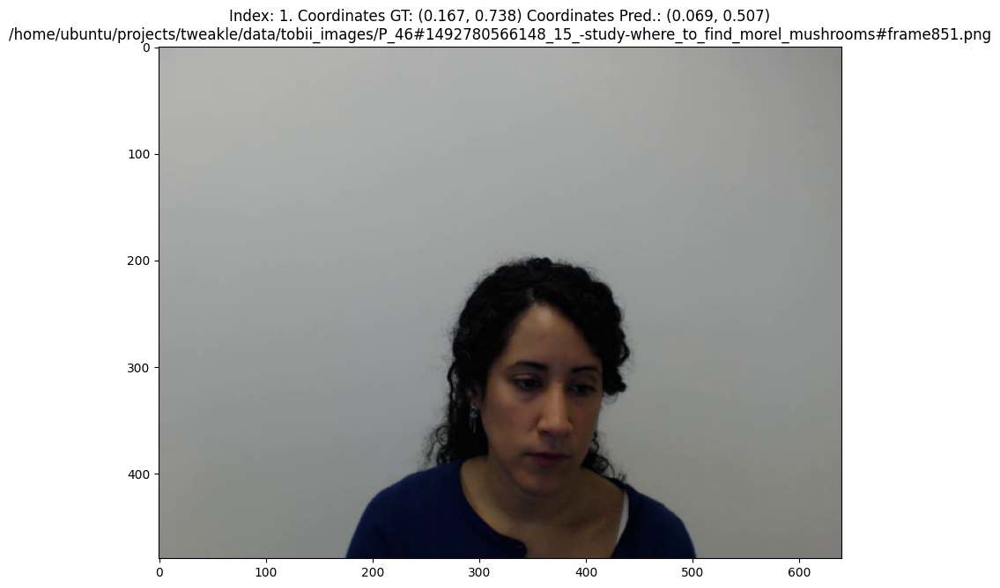

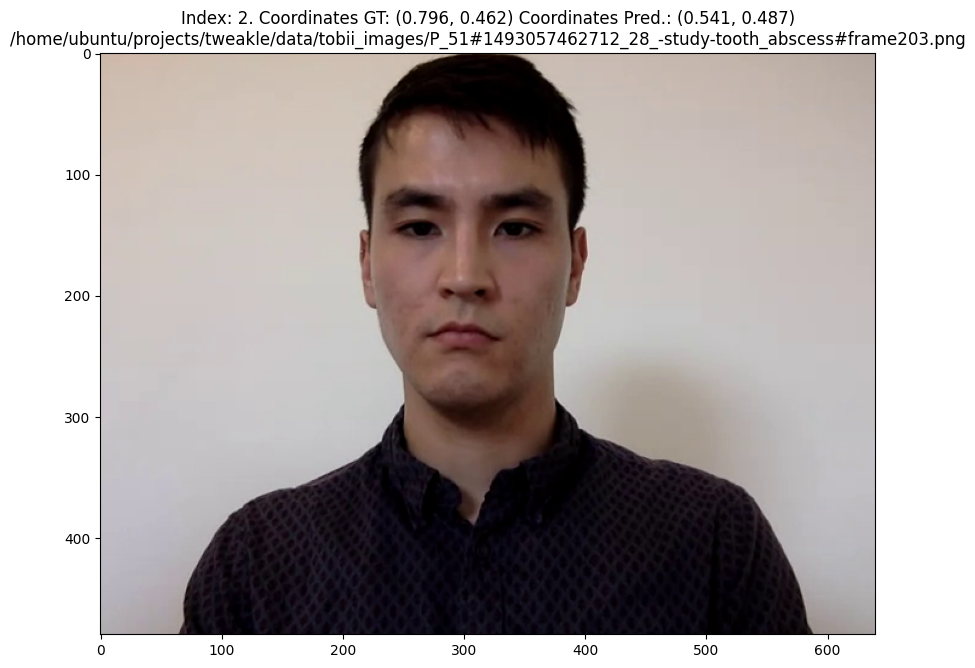

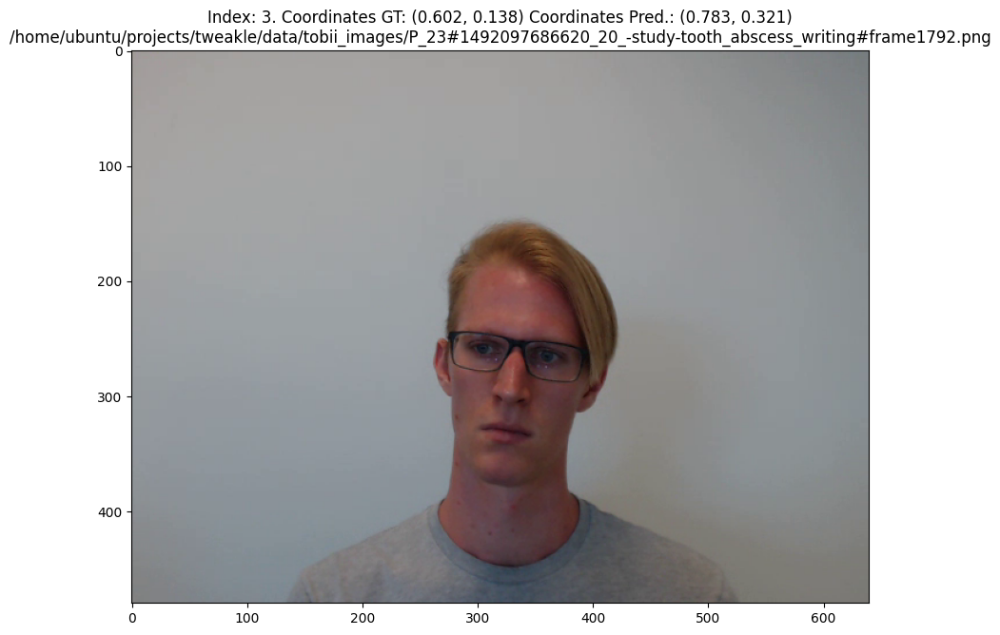

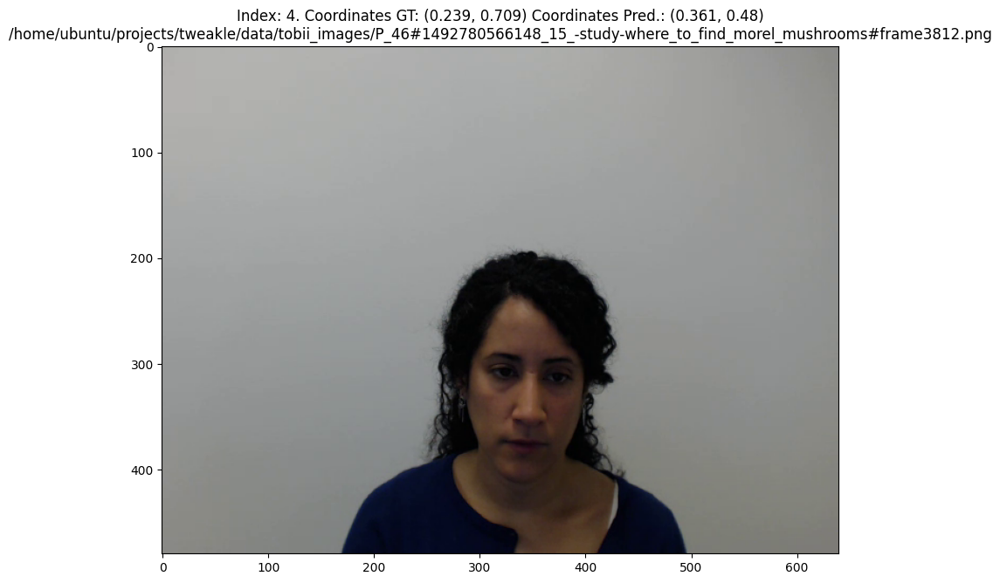

...

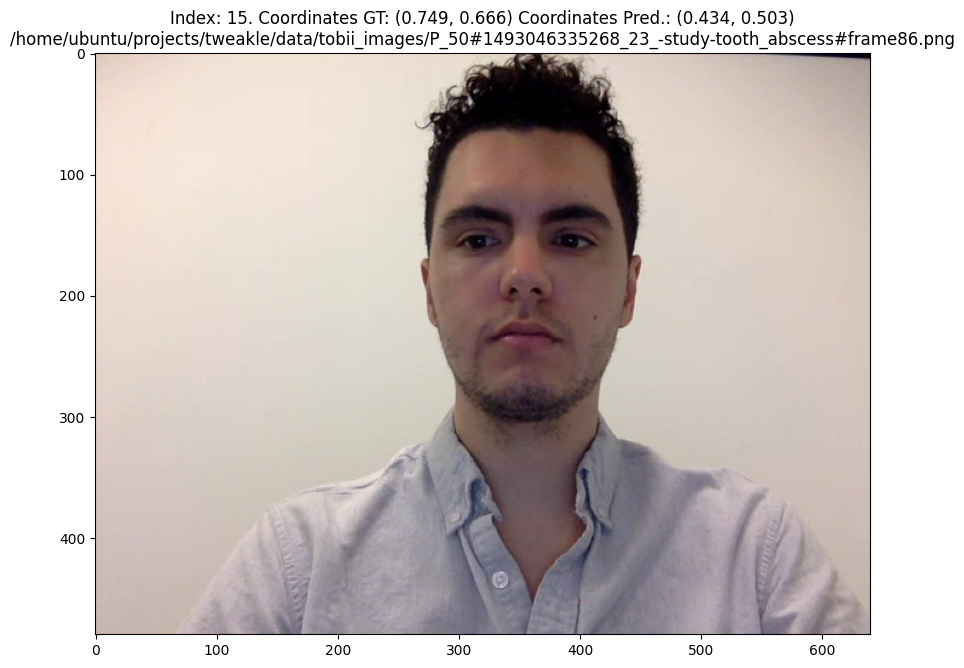

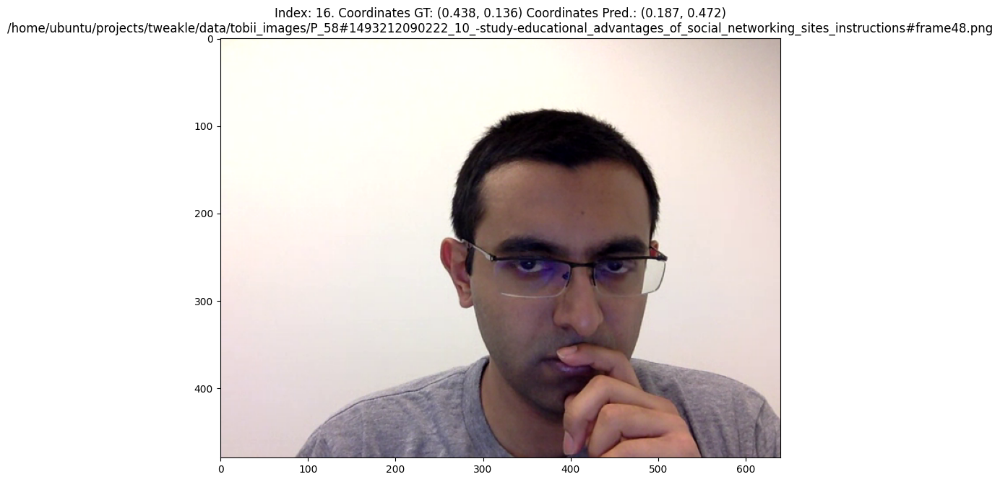

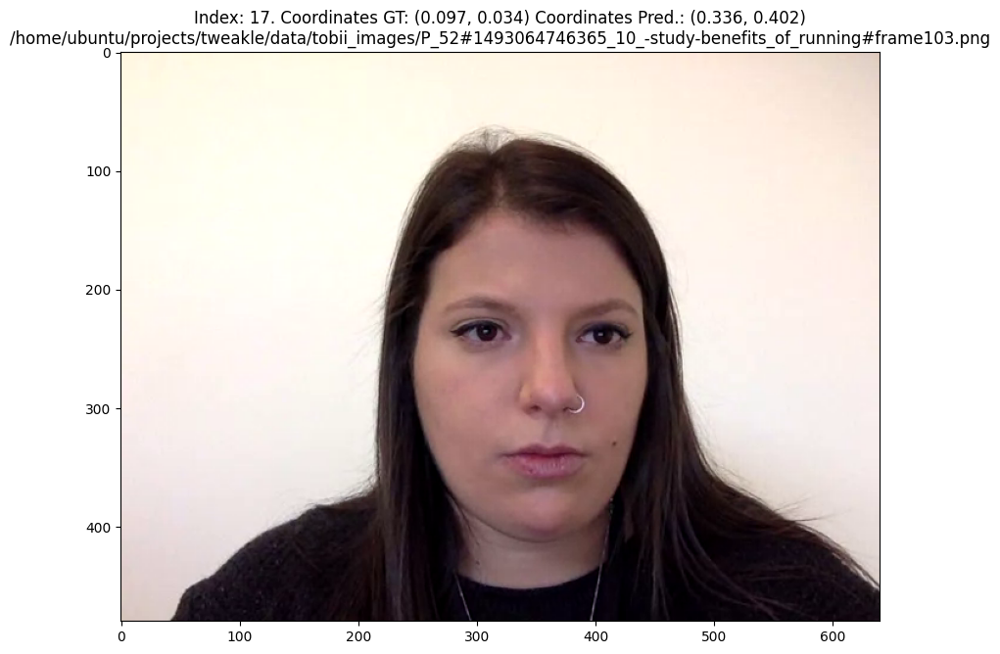

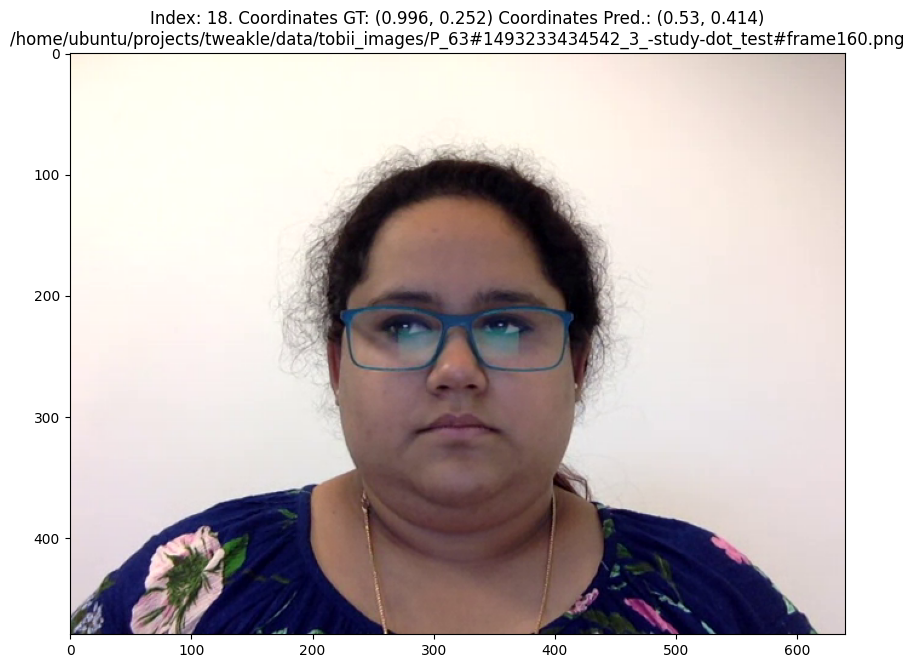

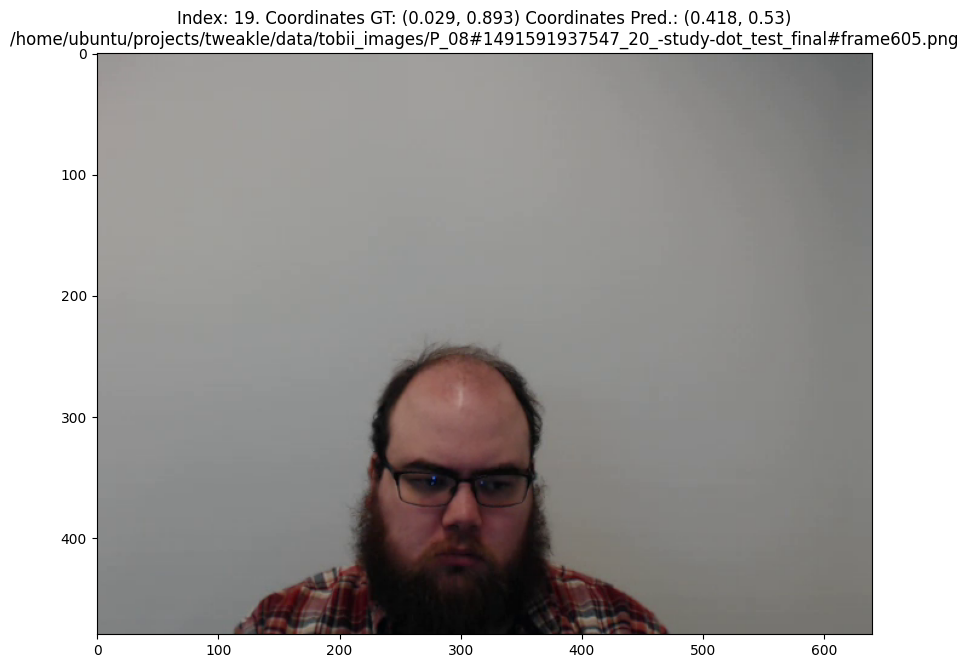

In [274]:
worst_subset = golden_test.sort_values("distances").tail(20)
for i in range(worst_subset.shape[0]):
    row = worst_subset.iloc[i]
    path = row['paths']
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 8))
    plt.title(f'Index: {i}. Coordinates GT: ({round(row["x_normalized"],3)}, {round(row["y_normalized"],3)}) '
              f'Coordinates Pred.: ({round(row["pred_x"],3)}, {round(row["pred_y"],3)})\n{row["paths"]}')
    plt.imshow(img)
    plt.show()

The metrics are the same. It seems like model need more info about face position in frame.